1
[ 1.          0.61441739  0.4526908  ... -0.02074086 -0.02048394
 -0.02382043]
[ 1.          0.61441739  0.4526908  ... -0.02074086 -0.02048394
 -0.02382043]
2001
[ 0.53355409  0.94914829  1.30656653 ... 22.66562998 22.64501757
 22.62286539]
1999
23.445459560021078
1
2
[1.         0.7262628  0.60617054 ... 0.03410631 0.03968663 0.03662574]
[1.         0.7262628  0.60617054 ... 0.03410631 0.03968663 0.03662574]
2001
[  0.66621667   1.2442263    1.77641715 ... 193.43949938 193.47639585
 193.51455203]
1999
191.72358811599992
2
3
[1.         0.65300153 0.49834072 ... 0.0302714  0.02956589 0.02801868]
[1.         0.65300153 0.49834072 ... 0.0302714  0.02956589 0.02801868]
2001
[ 0.57567112  1.03819787  1.44361065 ... 73.85413144 73.88405009
 73.91284237]
1999
72.20287651852482
3
4
[ 1.          0.61491636  0.45871556 ... -0.00121877 -0.00456727
 -0.00585154]
[ 1.          0.61491636  0.45871556 ... -0.00121877 -0.00456727
 -0.00585154]
2001
[ 0.53681596  0.96116617  1.32753493 ... 16.5513

[ 0.59269904  1.06932209  1.47976303 ... 34.13576377 34.1021564
 34.06658398]
1999
35.29984895892253
32
33
[ 1.          0.66893613  0.52039881 ... -0.0044145  -0.00142249
  0.00434584]
[ 1.          0.66893613  0.52039881 ... -0.0044145  -0.00142249
  0.00434584]
2001
[ 0.59466747  1.07905127  1.50129946 ... 78.56800927 78.56509078
 78.56655245]
1999
78.2151212550171
33
34
[1.         0.70093292 0.5620217  ... 0.00277339 0.002622   0.0020344 ]
[1.         0.70093292 0.5620217  ... 0.00277339 0.002622   0.0020344 ]
2001
[ 0.63147731  1.16014992  1.63025316 ... 56.26023687 56.26293457
 56.26526277]
1999
56.72780262632243
34
35
[ 1.00000000e+00  6.53710889e-01  4.95915209e-01 ... -8.92120529e-05
 -1.59915210e-03 -3.60230500e-03]
[ 1.00000000e+00  6.53710889e-01  4.95915209e-01 ... -8.92120529e-05
 -1.59915210e-03 -3.60230500e-03]
2001
[ 0.57481305  1.02920326  1.41323328 ... 22.92627364 22.92542946
 22.92282873]
1999
23.09533147856354
35
36
[1.         0.68799816 0.54774928 ... 0.0627881

<Figure size 1440x432 with 0 Axes>

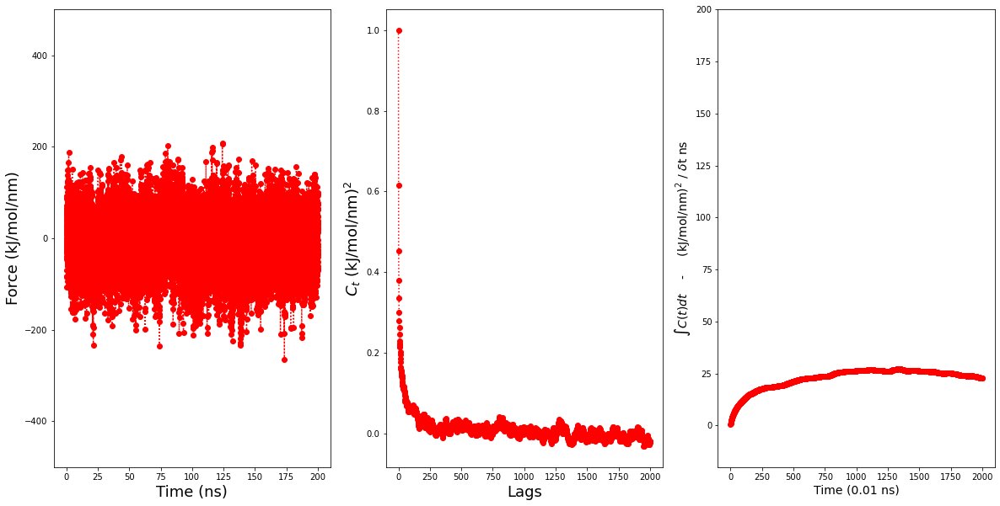

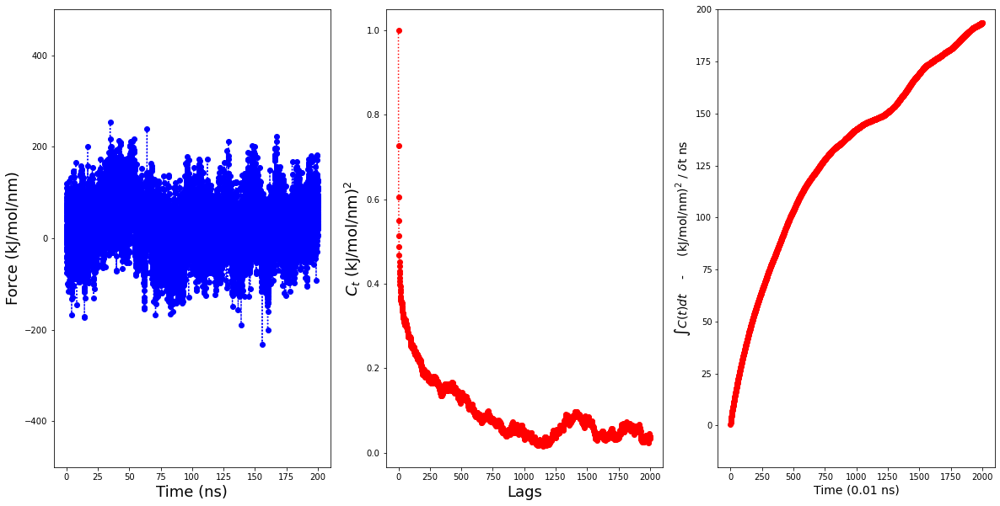

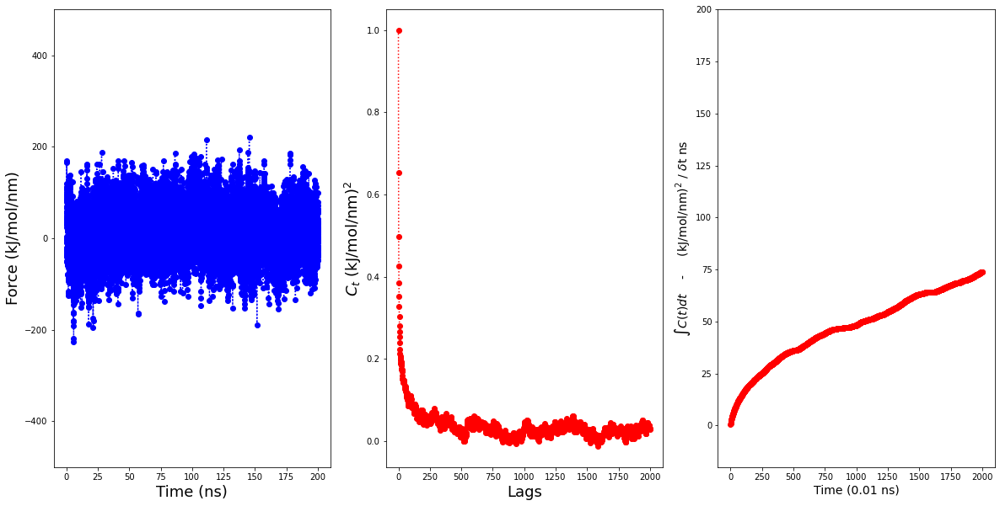

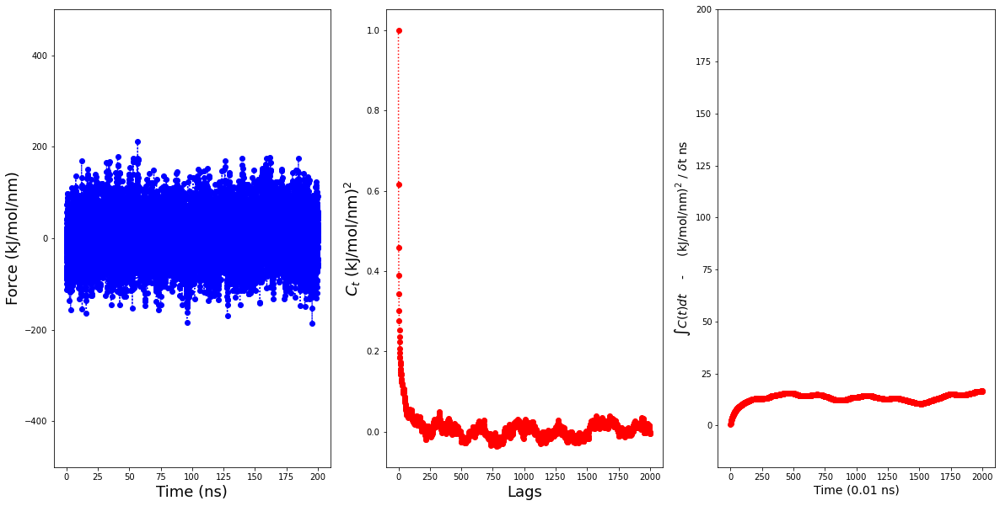

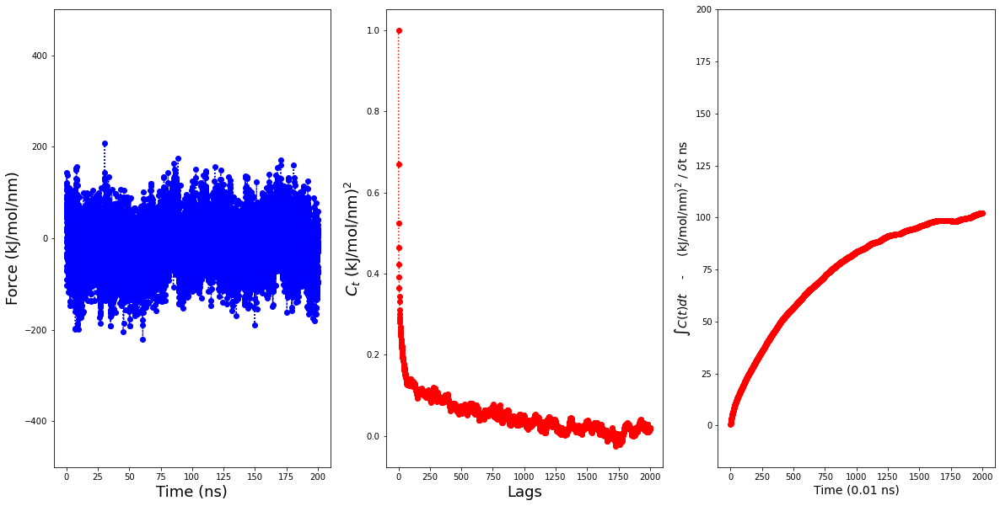

...

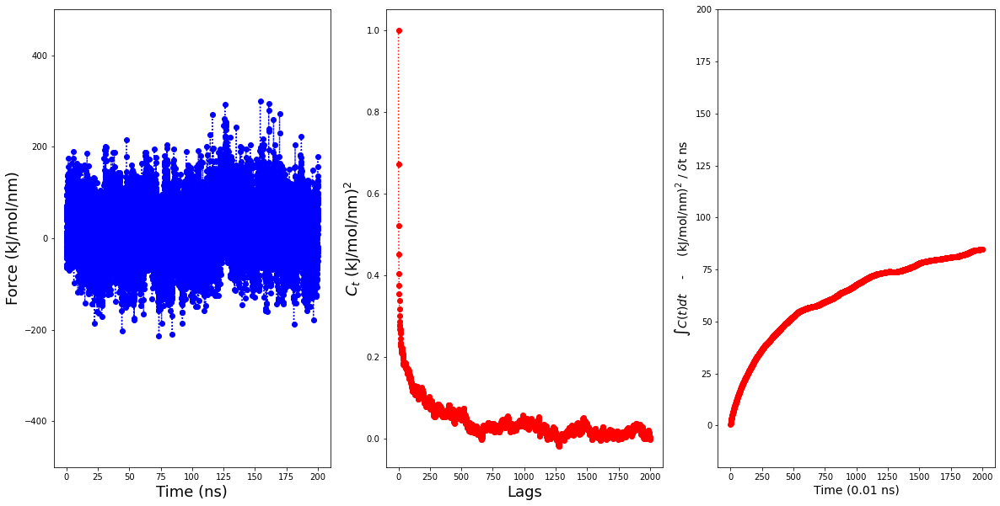

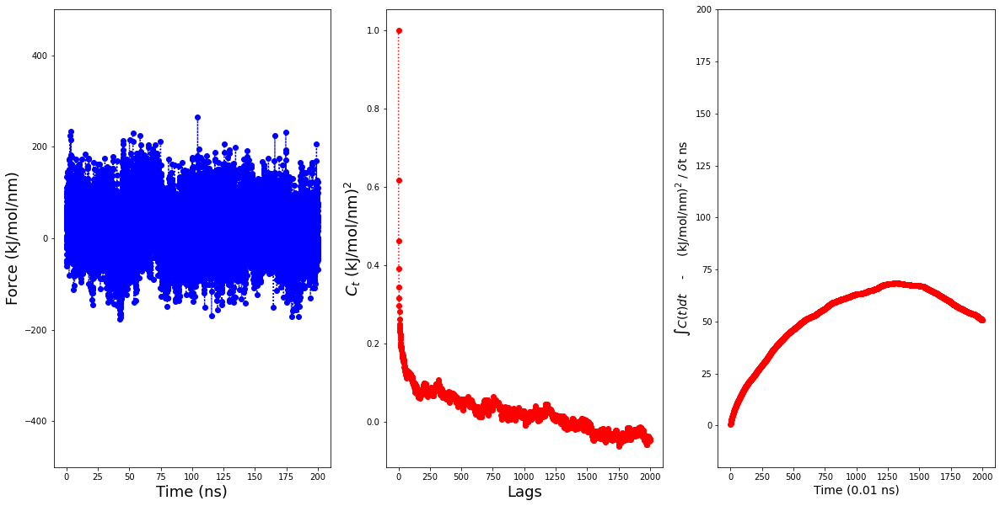

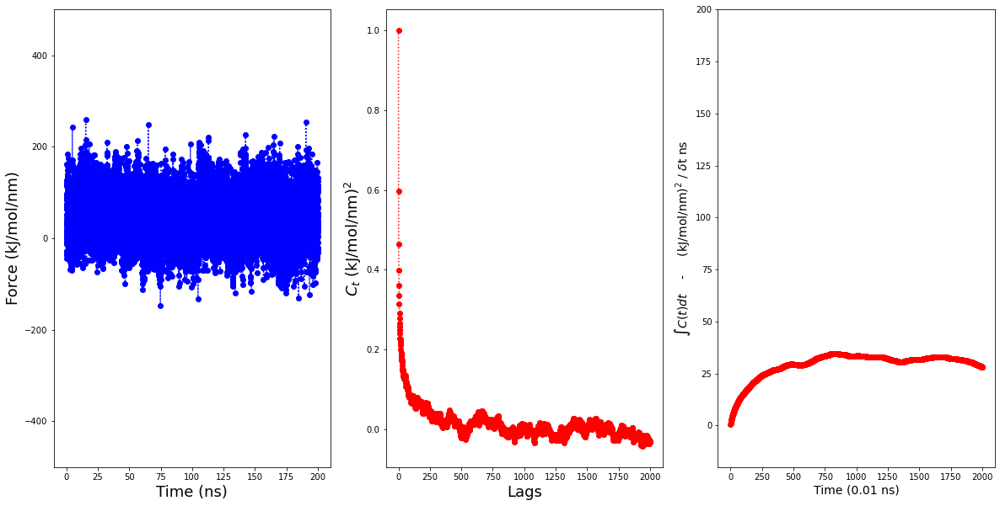

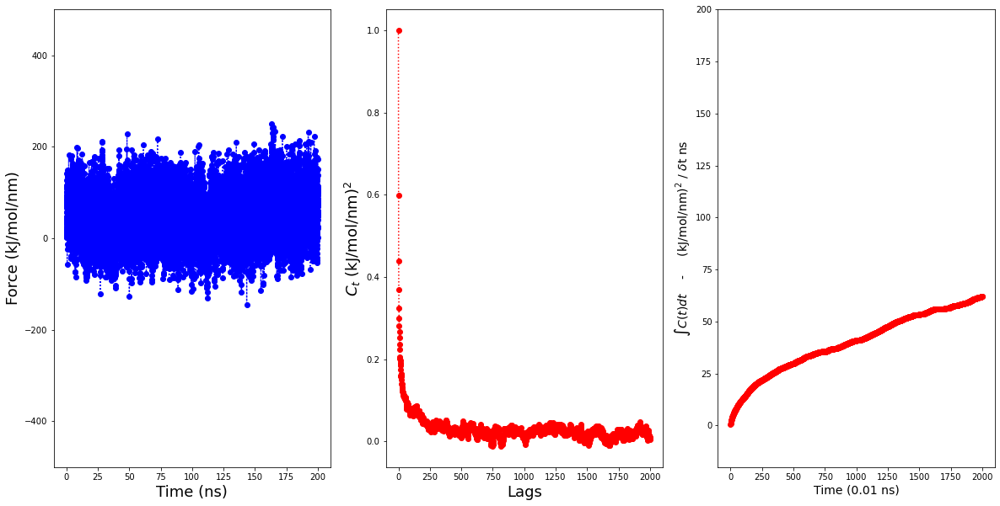

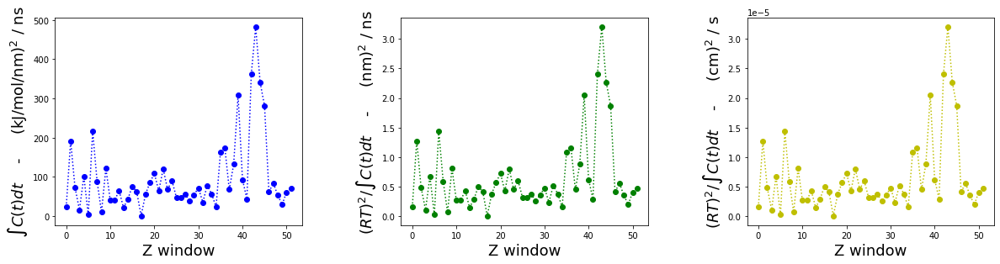

In [28]:
#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_Caff_5000eq_0.2/Force_prod/All_new/Convolve_100')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=2000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           
 

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr
np.savetxt("test6.txt", last_, delimiter=" ", fmt="%s") 

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = rt*rt

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = rt2_*invert_last
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100.png',dpi=300,bbox_inches='tight',pad_inches=0.2)

1
[ 1.00000000e+00  5.94275801e-01  4.34720905e-01 ...  3.82847020e-03
 -7.50833830e-04 -2.42838734e-03]
[ 1.00000000e+00  5.94275801e-01  4.34720905e-01 ...  3.82847020e-03
 -7.50833830e-04 -2.42838734e-03]
2001
[ 0.51449835  0.91019606  1.24339525 ... 49.46621824 49.46775706
 49.46616745]
1999
49.772510589848416
1
2
[1.         0.60660015 0.44641644 ... 0.02053542 0.01851578 0.02315163]
[1.         0.60660015 0.44641644 ... 0.02053542 0.01851578 0.02315163]
2001
[ 0.52650829  0.93272861  1.27618106 ... 11.56103487 11.58056047
 11.60139417]
1999
11.347640353580124
2
3
[ 1.          0.65876748  0.51703192 ... -0.02063278 -0.02130055
 -0.01981379]
[ 1.          0.65876748  0.51703192 ... -0.02063278 -0.02130055
 -0.01981379]
2001
[ 0.5878997   1.07124955  1.49805049 ... 91.78568832 91.76472166
 91.74416449]
1999
92.74293241046338
3
4
[ 1.          0.63213918  0.48356497 ... -0.00676632 -0.00669308
 -0.00694452]
[ 1.          0.63213918  0.48356497 ... -0.00676632 -0.00669308
 -0.0069445

[ 0.56313481  1.01487066  1.40836629 ... 89.95945972 89.98212636
 90.00166257]
1999
89.12561121047312
32
33
[1.         0.65487854 0.50979311 ... 0.02319293 0.02738129 0.03522719]
[1.         0.65487854 0.50979311 ... 0.02319293 0.02738129 0.03522719]
2001
[  0.58233583   1.05661219   1.47867388 ... 117.240987   117.26627411
 117.29757836]
1999
116.07808659990702
33
34
[ 1.          0.58935844  0.44787602 ... -0.02430202 -0.02666491
 -0.0228904 ]
[ 1.          0.58935844  0.44787602 ... -0.02430202 -0.02666491
 -0.0228904 ]
2001
[ 0.51861723  0.93088527  1.28730231 ... 39.13430224 39.10881877
 39.08404111]
1999
39.95630275606637
34
35
[ 1.          0.60522221  0.45152814 ... -0.0132176  -0.01233446
 -0.02039651]
[ 1.          0.60522221  0.45152814 ... -0.0132176  -0.01233446
 -0.02039651]
2001
[ 0.52837517  0.93914222  1.28632637 ... 17.53554169 17.52276566
 17.50640017]
1999
18.28057502232364
35
36
[1.         0.61515261 0.4644947  ... 0.01546791 0.00838369 0.00572187]
[1.         0.

<Figure size 1440x432 with 0 Axes>

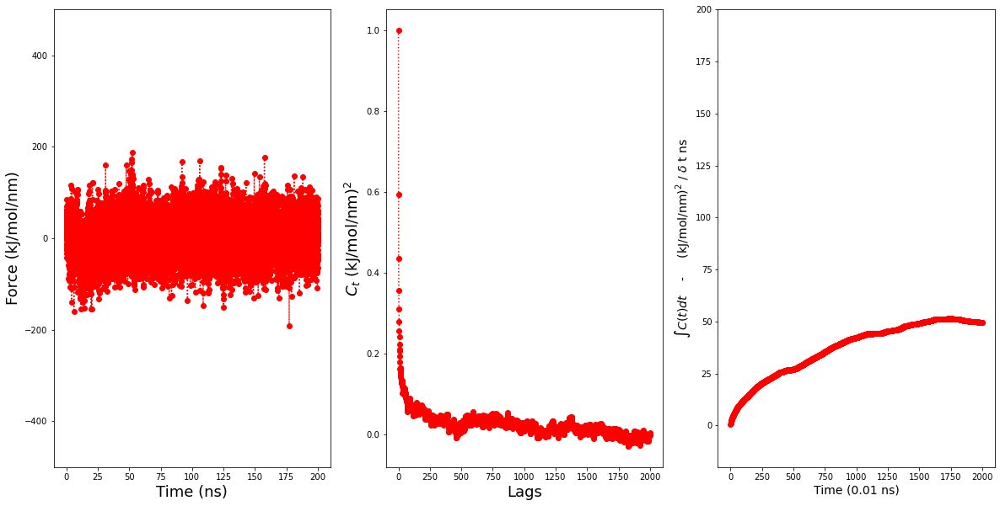

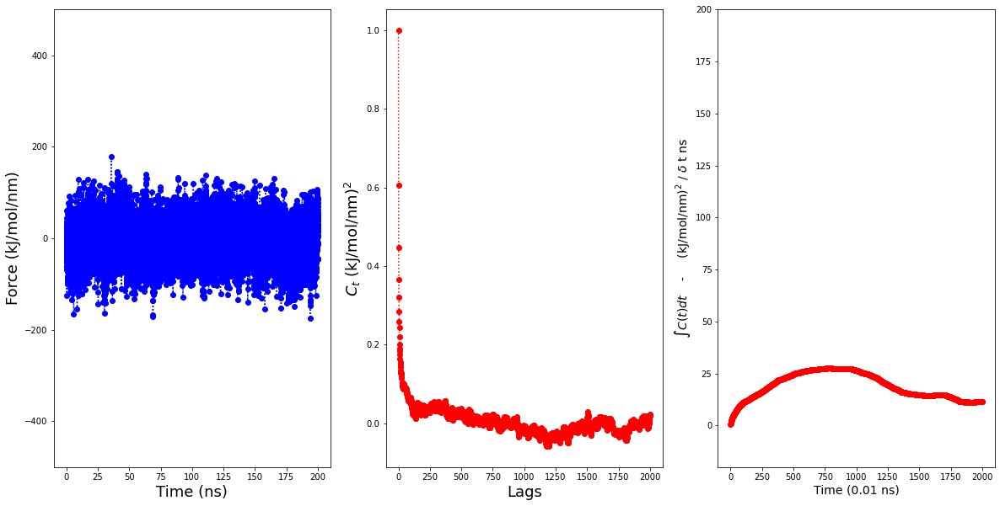

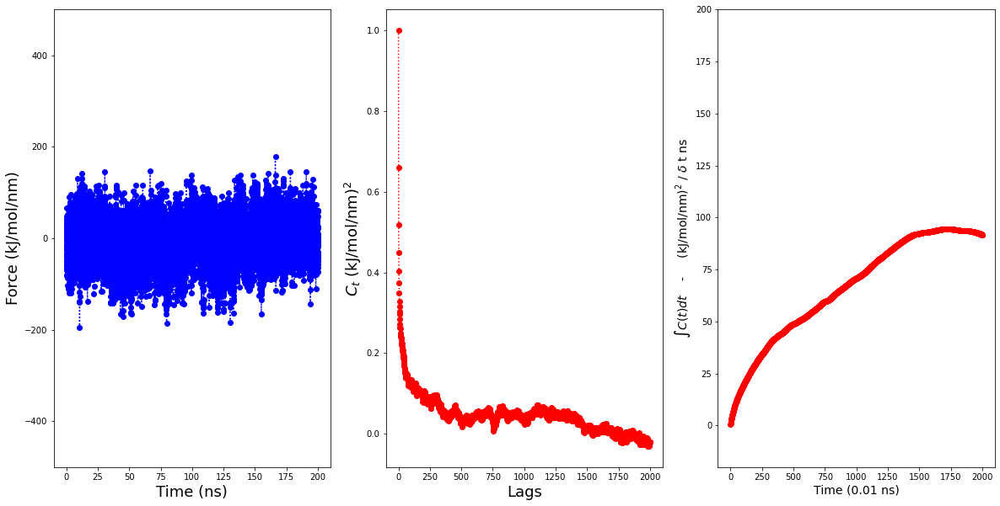

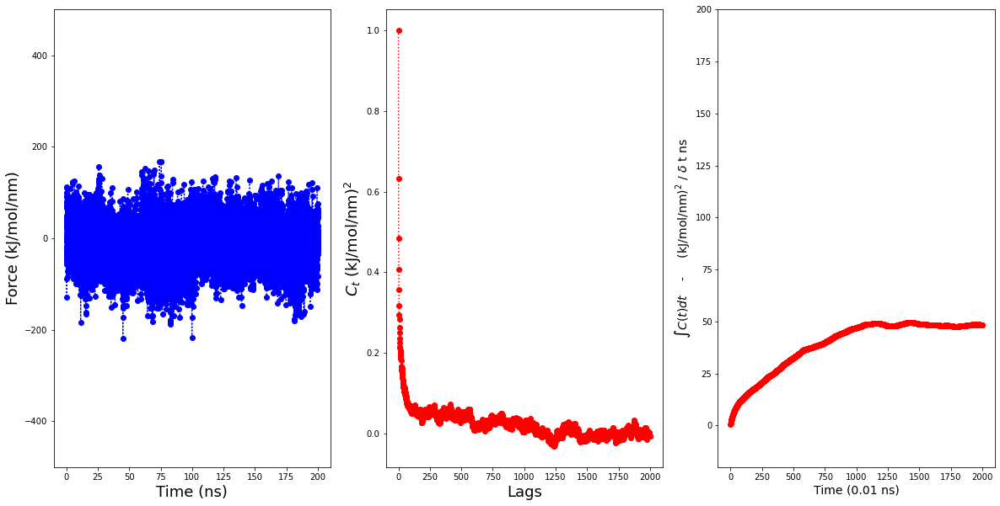

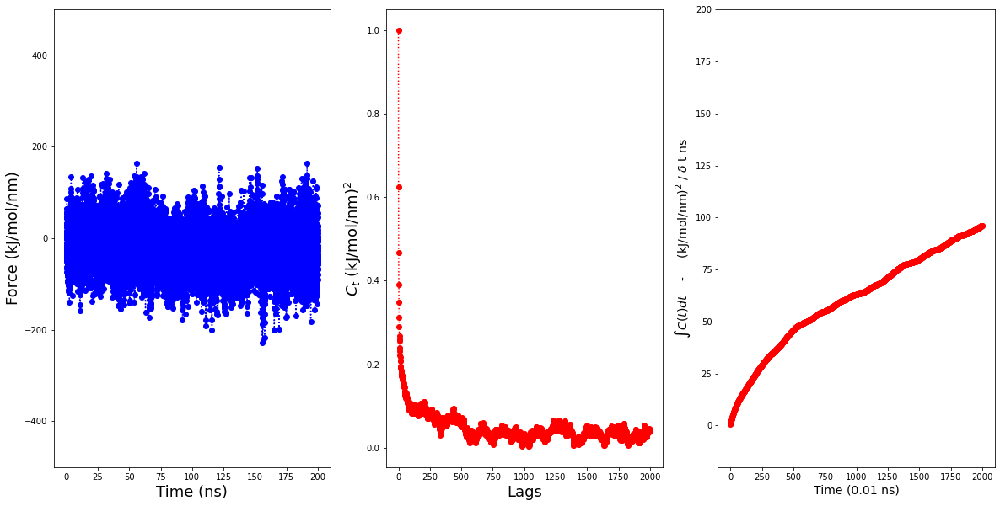

...

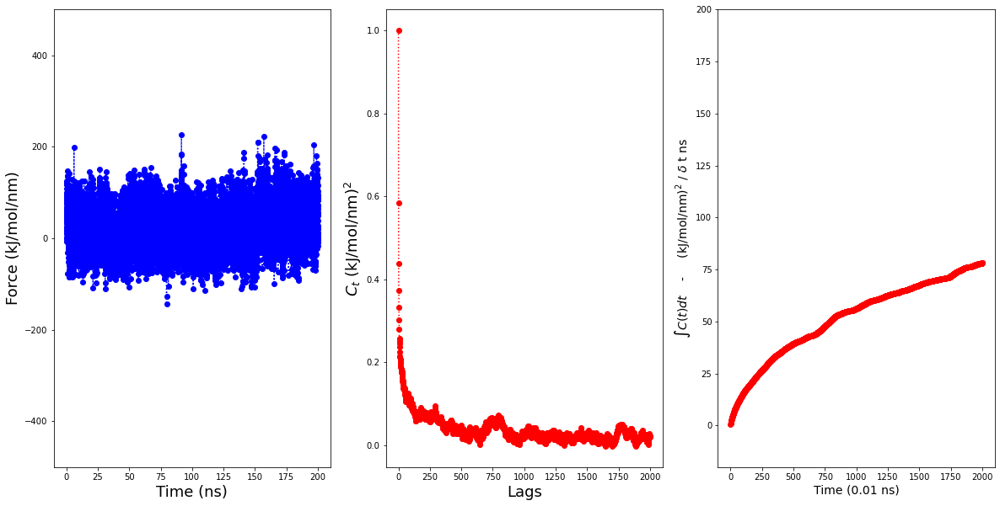

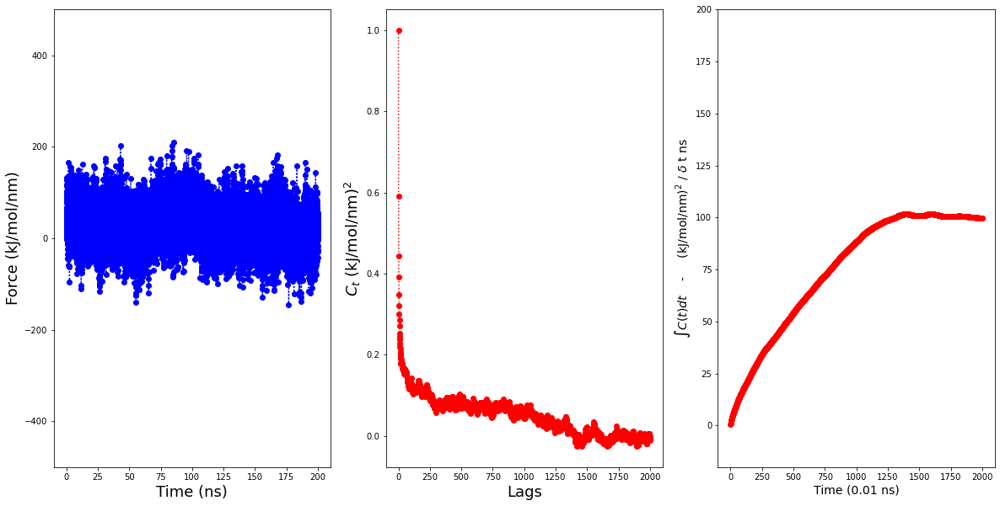

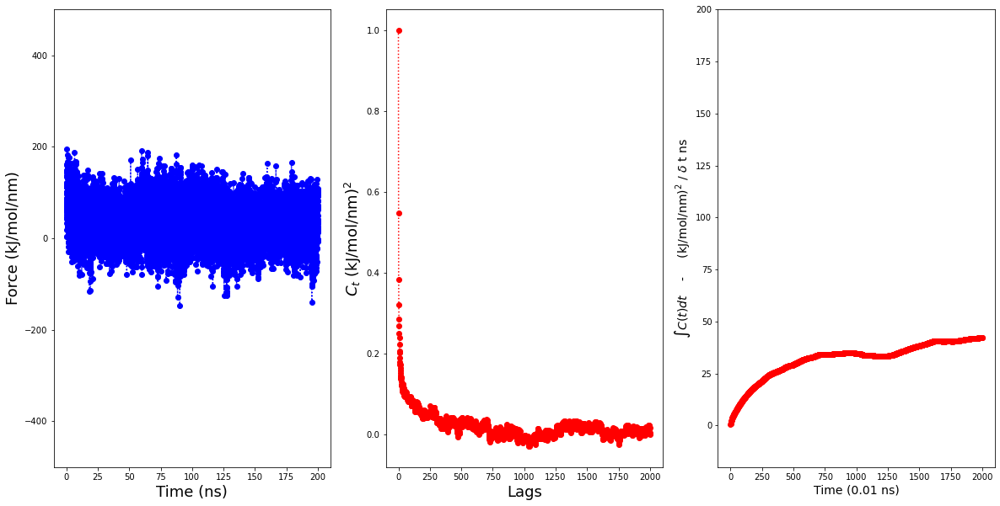

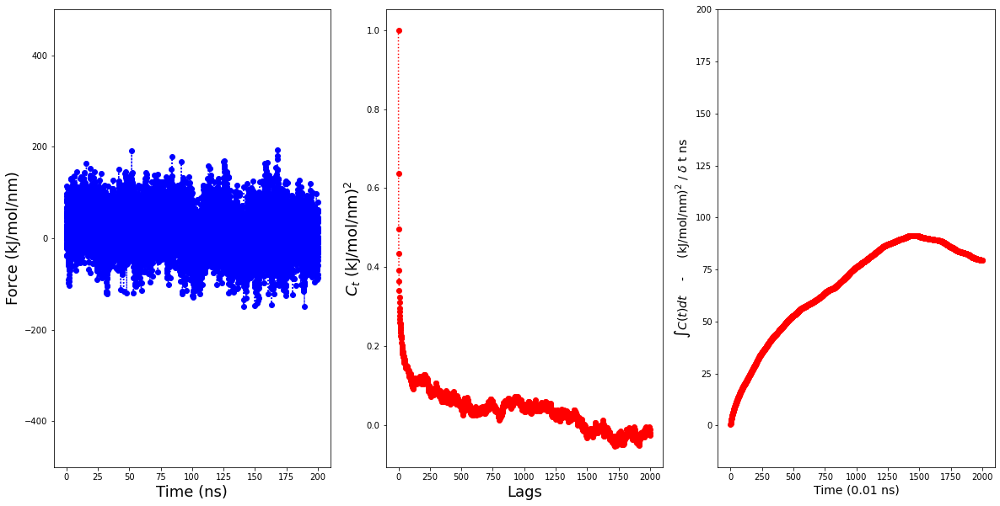

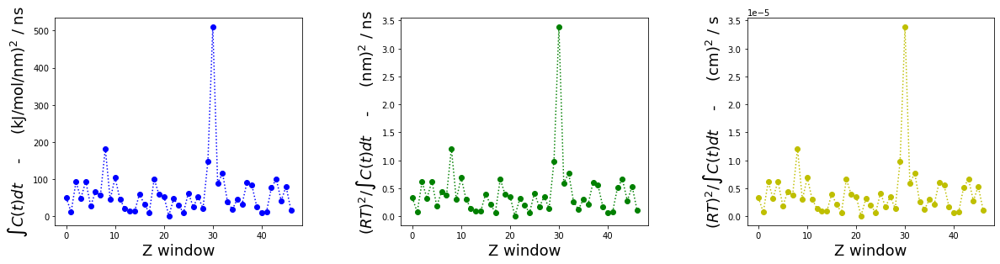

In [29]:
#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_2MR_5000eq_0.2/Force_prod/All_new/Convolve_2MR')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=2000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           

            #np.savetxt("test.txt", bla5, delimiter=" ", fmt="%s") 
            #np.savetxt("test3.txt", save_acf, delimiter=" ", fmt="%s") 


            #np.savetxt("test2.txt", save_acf_, delimiter=" ", fmt="%s")

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$ t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = rt*rt

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = rt2_*invert_last
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100_2MR.png',dpi=300,bbox_inches='tight',pad_inches=0.2)

1
[ 1.          0.5904402   0.41562636 ... -0.01033458 -0.00594588
 -0.00632657]
[ 1.          0.5904402   0.41562636 ... -0.01033458 -0.00594588
 -0.00632657]
2001
[ 0.50303328  0.87221463  1.17061137 ... 12.62160632 12.6134661
 12.60732987]
1999
12.980887671789437
1
2
[ 1.          0.61232345  0.44505357 ... -0.01368543 -0.01884084
 -0.01117547]
[ 1.          0.61232345  0.44505357 ... -0.01368543 -0.01884084
 -0.01117547]
2001
[ 0.52868851  0.93225304  1.26829466 ... 34.22035888 34.20409574
 34.18908759]
1999
34.20119441112637
2
3
[1.         0.60076188 0.44104996 ... 0.00873991 0.00289715 0.00521024]
[1.         0.60076188 0.44104996 ... 0.00873991 0.00289715 0.00521024]
2001
[ 0.52090592  0.92406468  1.26388022 ... 41.98168456 41.98750309
 41.99155679]
1999
41.96319146877191
3
4
[1.         0.5638458  0.39102475 ... 0.00855268 0.01464921 0.00660186]
[1.         0.5638458  0.39102475 ... 0.00855268 0.01464921 0.00660186]
2001
[ 0.47743528  0.83281469  1.1259756  ... 16.30819918 16.

[ 0.5665309   1.01746744  1.40662057 ... 67.10778296 67.14850092
 67.18812829]
1999
65.65377163320589
31
32
[ 1.00000000e+00  5.84707076e-01  4.29699235e-01 ... -9.91657628e-04
 -7.68192054e-04 -2.71498445e-03]
[ 1.00000000e+00  5.84707076e-01  4.29699235e-01 ... -9.91657628e-04
 -7.68192054e-04 -2.71498445e-03]
2001
[ 0.50720316  0.90284839  1.24402377 ... 75.15508735 75.15420742
 75.15246583]
1999
75.43595125890899
32
33
[ 1.          0.62174138  0.45428755 ... -0.00313178 -0.00163138
 -0.00153565]
[ 1.          0.62174138  0.45428755 ... -0.00313178 -0.00163138
 -0.00153565]
2001
[ 0.53801446  0.95647753  1.31930722 ... 40.57155832 40.56917674
 40.56759323]
1999
39.98555572565272
33
34
[ 1.00000000e+00  6.46094640e-01  4.93292758e-01 ... -3.43603407e-03
 -5.05679951e-04 -2.18118932e-03]
[ 1.00000000e+00  6.46094640e-01  4.93292758e-01 ... -3.43603407e-03
 -5.05679951e-04 -2.18118932e-03]
2001
[ 0.5696937   1.02505409  1.41629869 ... 28.14958383 28.14761297
 28.14626954]
1999
28.4180

<Figure size 1440x432 with 0 Axes>

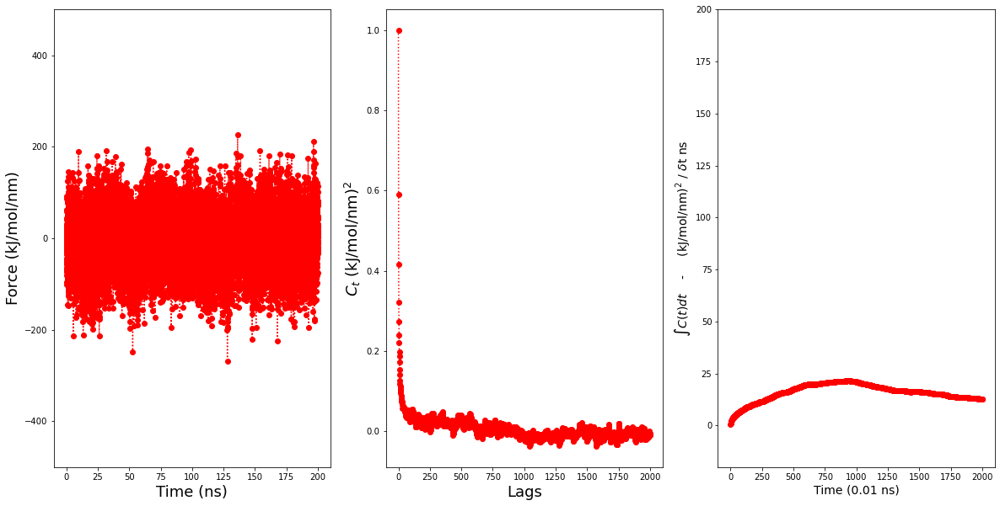

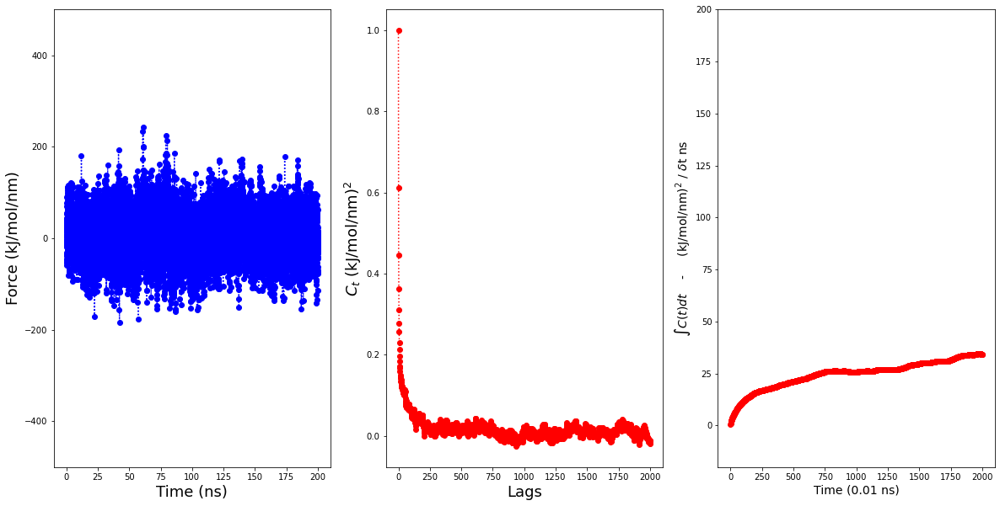

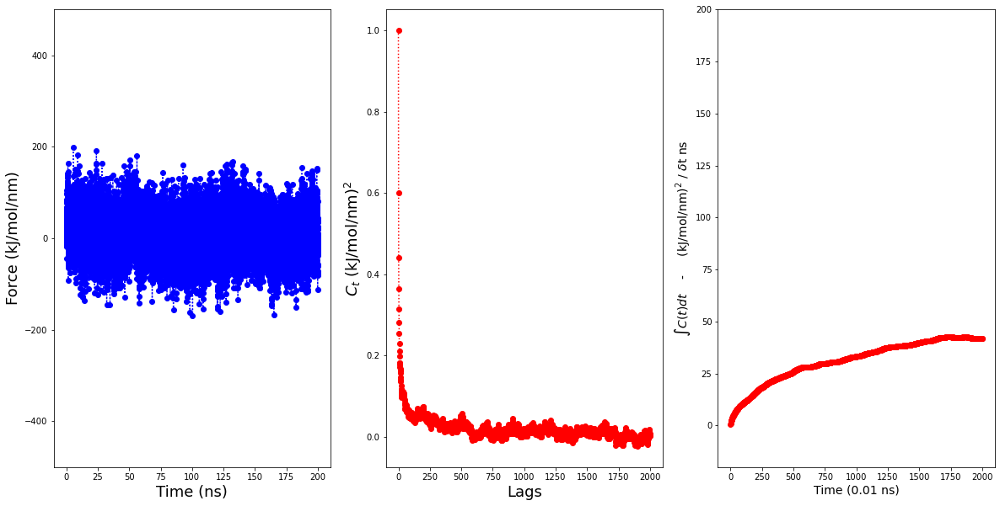

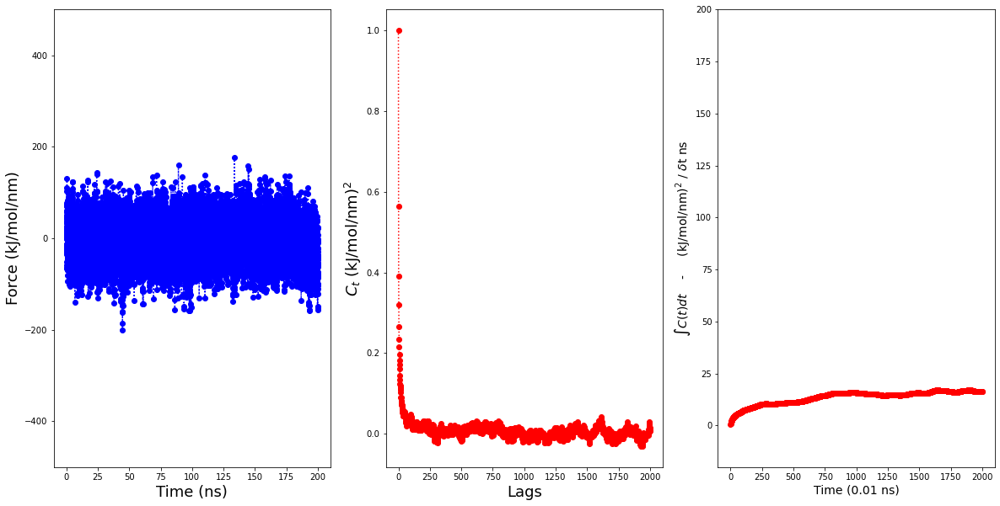

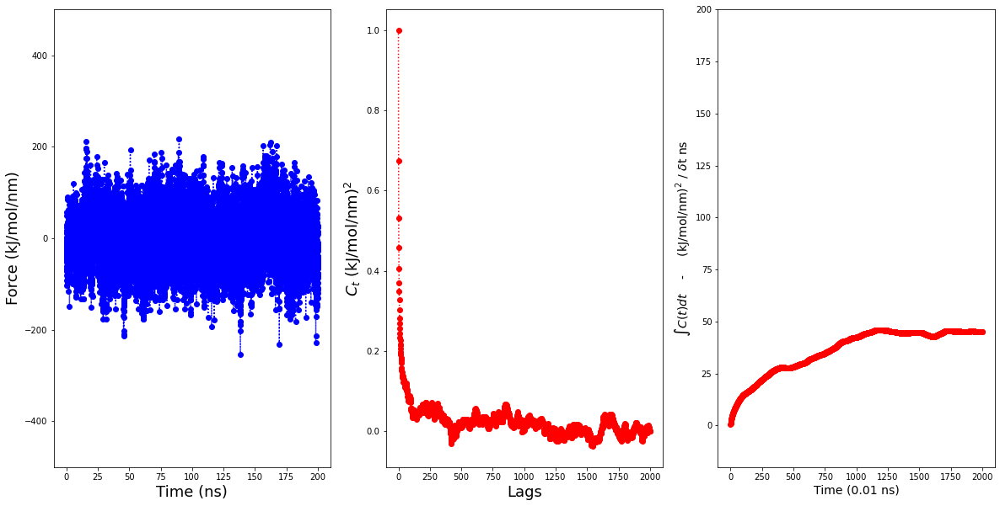

...

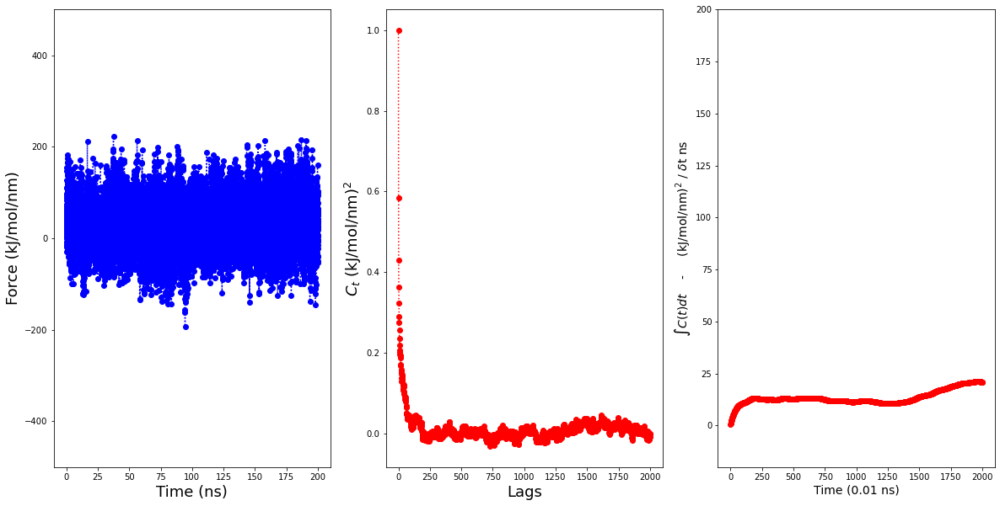

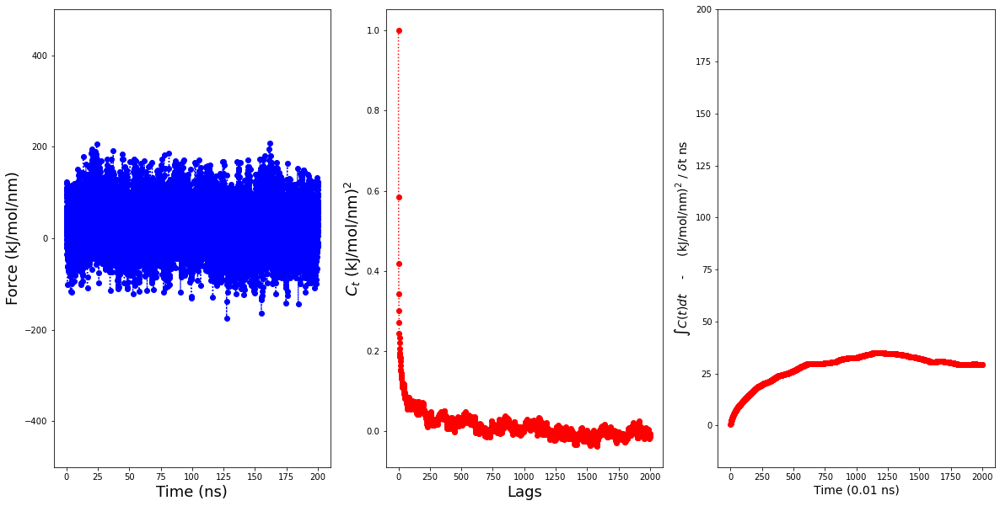

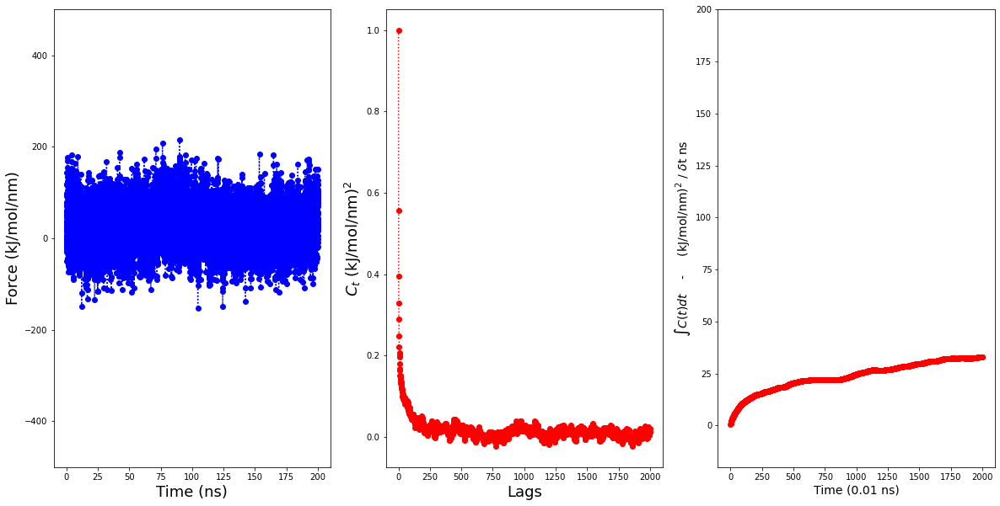

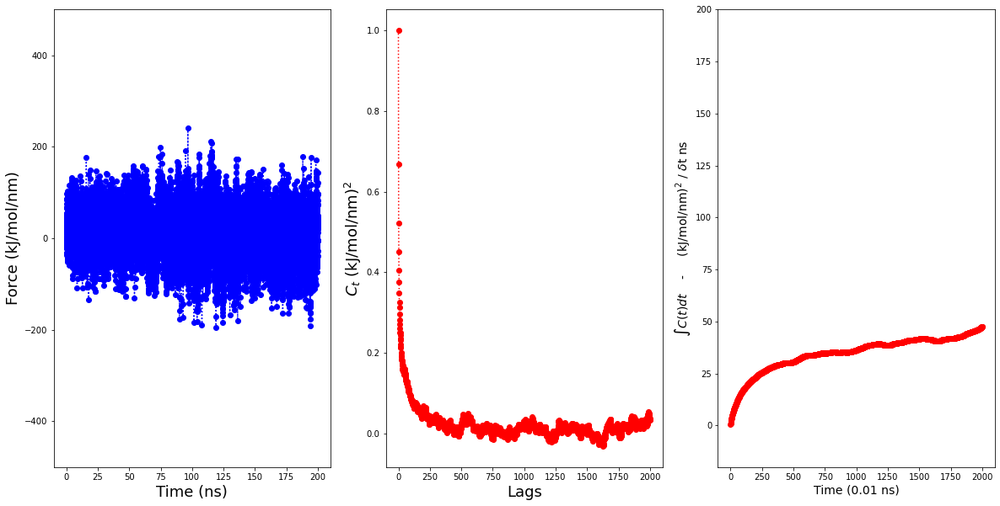

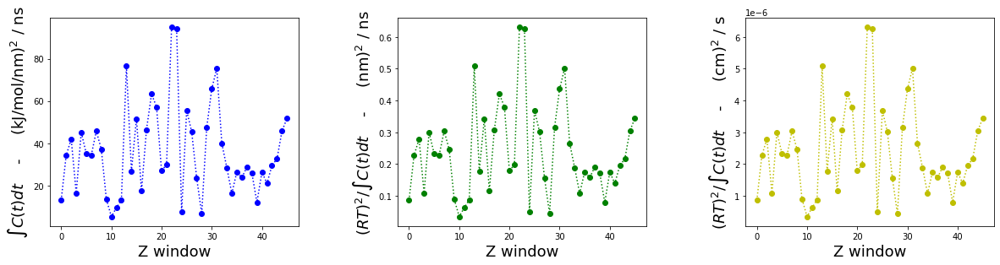

In [35]:
#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_DPG_5000eq_0.2/All_new_/Convolve_100')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=2000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           

            #np.savetxt("test.txt", bla5, delimiter=" ", fmt="%s") 
            #np.savetxt("test3.txt", save_acf, delimiter=" ", fmt="%s") 


            #np.savetxt("test2.txt", save_acf_, delimiter=" ", fmt="%s")

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = rt*rt

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = rt2_*invert_last
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100_DPG.png',dpi=300,bbox_inches='tight',pad_inches=0.2)

1
[1.00000000e+00 6.71813555e-01 5.23057770e-01 ... 4.83568476e-04
 2.74496608e-03 9.60662049e-04]
[1.00000000e+00 6.71813555e-01 5.23057770e-01 ... 4.83568476e-04
 2.74496608e-03 9.60662049e-04]
2001
[0.59743566 1.08050472 1.49869725 ... 5.99509432 5.99670858 5.9985614 ]
1999
5.664683043831866
1
2
[1.         0.61312269 0.4496774  ... 0.0103766  0.01580459 0.01602275]
[1.         0.61312269 0.4496774  ... 0.0103766  0.01580459 0.01602275]
2001
[ 0.53140004  0.9437669   1.29347648 ... 16.69477792 16.70786852
 16.72378219]
1999
16.252351660611566
2
3
[ 1.          0.59563756  0.43997628 ... -0.00849524 -0.00367235
  0.00846585]
[ 1.          0.59563756  0.43997628 ... -0.00849524 -0.00367235
  0.00846585]
2001
[ 0.51780692  0.92085538  1.26381885 ... 15.2587527  15.2526689
 15.25506566]
1999
15.7358382280798
3
4
[1.         0.58580263 0.41764363 ... 0.01594803 0.02133694 0.02196848]
[1.         0.58580263 0.41764363 ... 0.01594803 0.02133694 0.02196848]
2001
[0.50172313 0.88082209 1.195

2001
[ 0.51389997  0.92328712  1.27716423 ... 47.4989152  47.50386243
 47.50690154]
1999
47.109334392557585
31
32
[ 1.          0.68042888  0.5576091  ... -0.00826596 -0.00849194
 -0.00628748]
[ 1.          0.68042888  0.5576091  ... -0.00826596 -0.00849194
 -0.00628748]
2001
[  0.61901899   1.14610198   1.62227095 ... 146.13363055 146.1252516
 146.1178619 ]
1999
145.51894546717023
32
33
[1.         0.67242882 0.53978249 ... 0.01638347 0.01911592 0.01684751]
[1.         0.67242882 0.53978249 ... 0.01638347 0.01911592 0.01684751]
2001
[ 0.60610565  1.11167693  1.55807304 ... 28.20102983 28.21877952
 28.23676123]
1999
27.163037734673804
33
34
[1.         0.66486887 0.52239868 ... 0.00400923 0.00873314 0.00959128]
[1.         0.66486887 0.52239868 ... 0.00400923 0.00873314 0.00959128]
2001
[ 0.59363377  1.0847429   1.52070066 ... 39.61308546 39.61945665
 39.62861886]
1999
38.990215312258776
34
35
[ 1.          0.61546588  0.48259749 ... -0.00921303 -0.0158452
 -0.01574346]
[ 1.          0

<Figure size 1440x432 with 0 Axes>

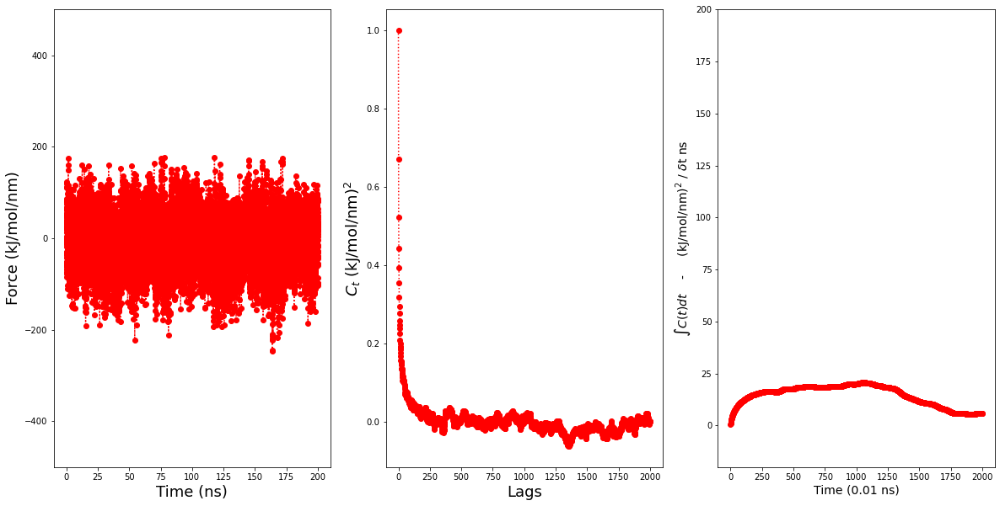

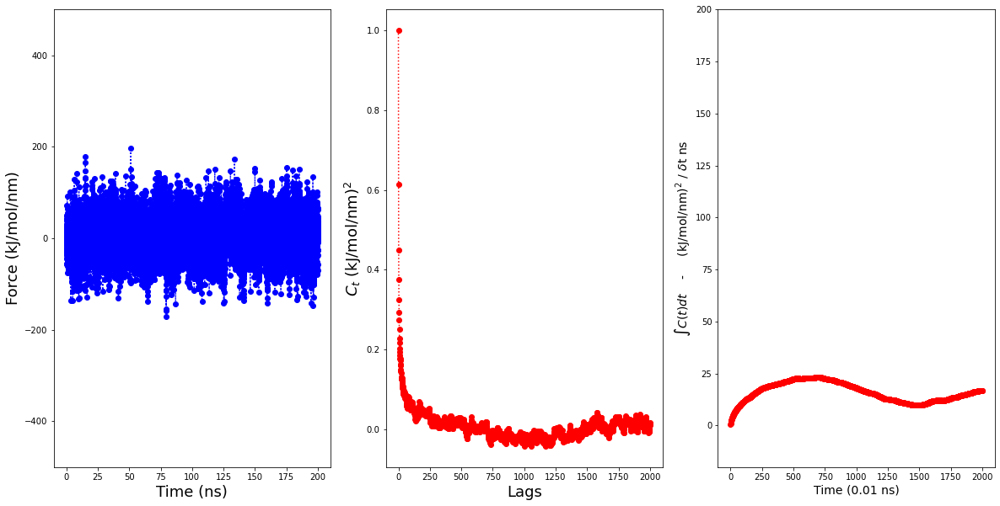

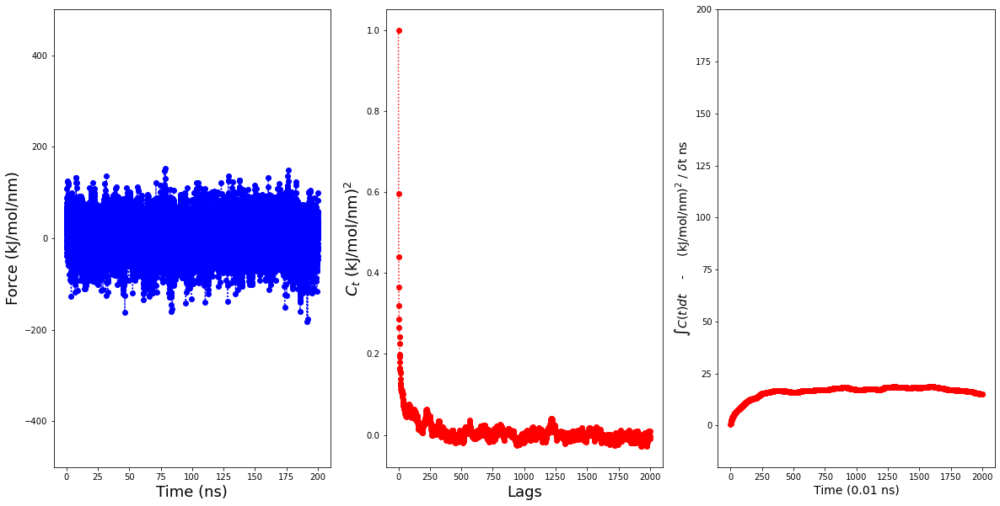

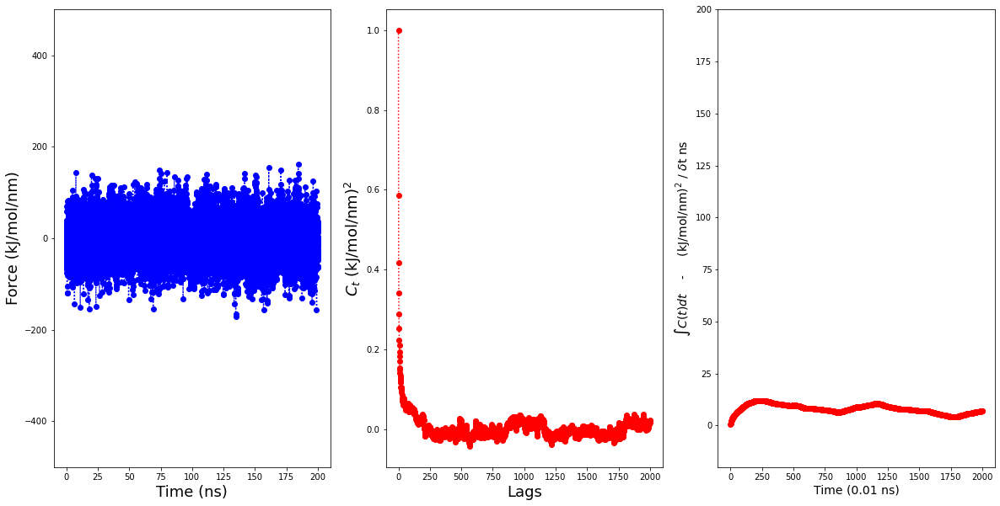

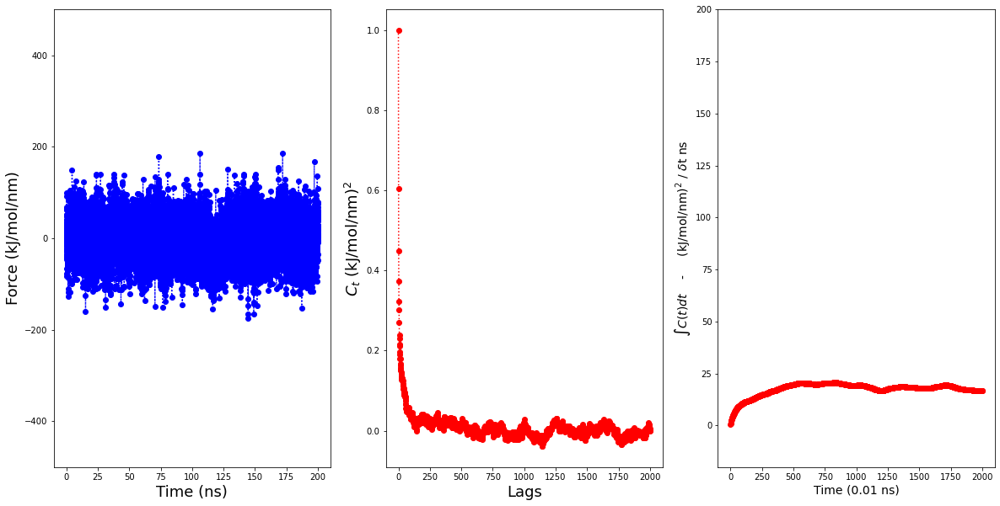

...

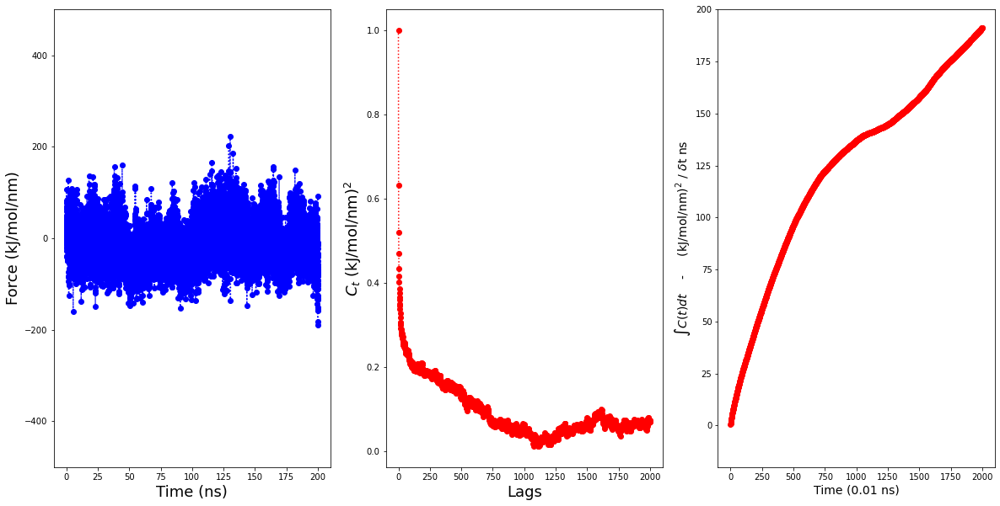

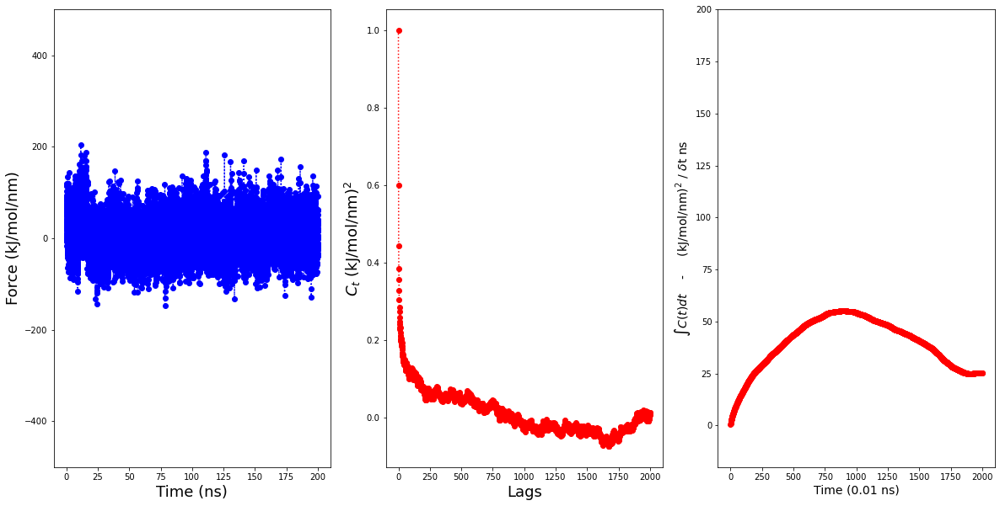

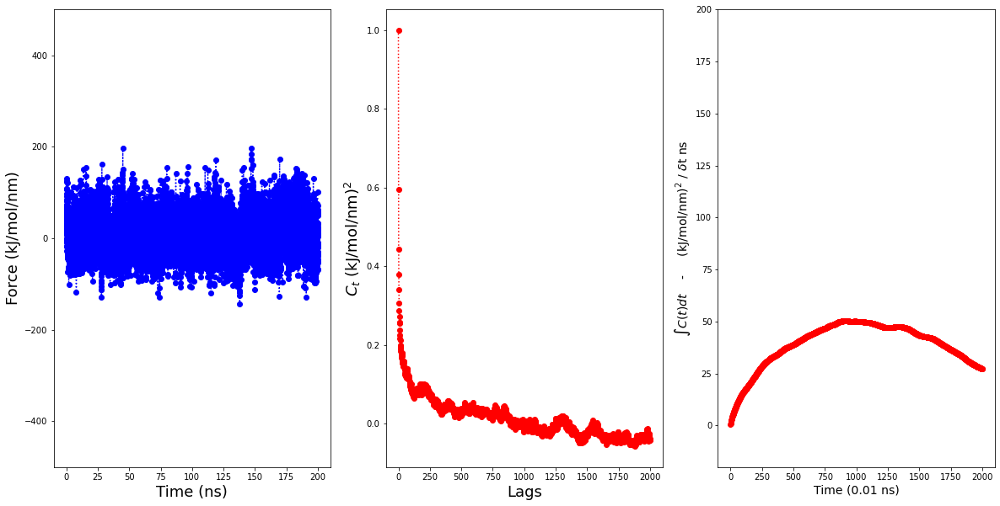

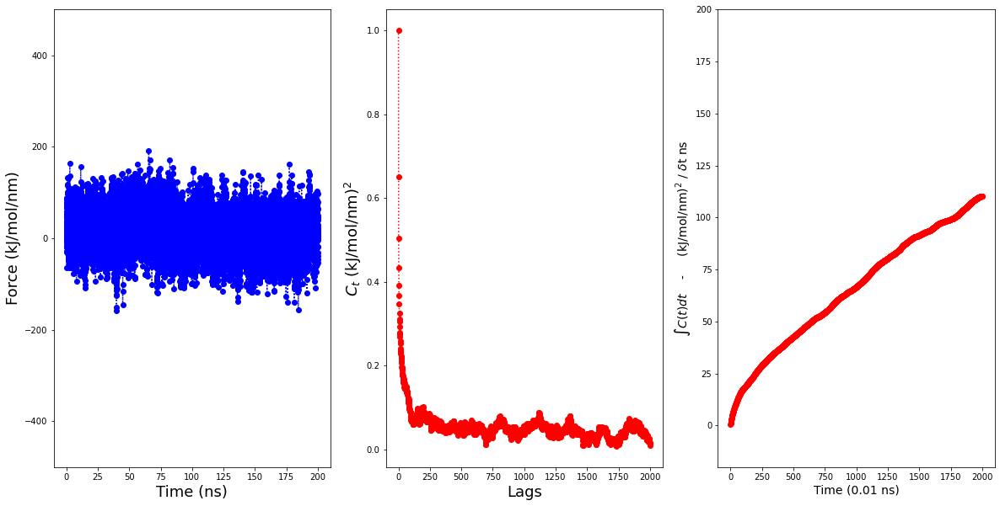

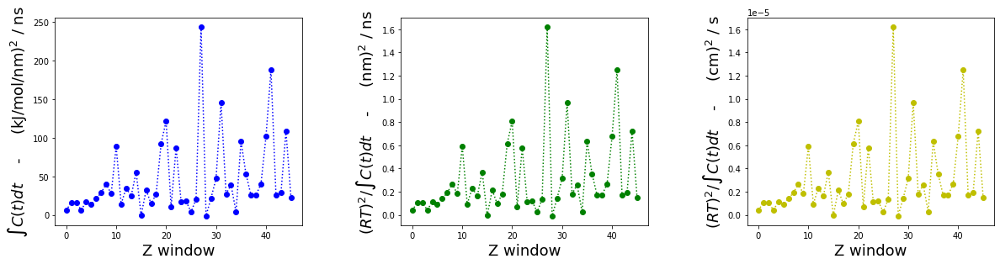

In [30]:
#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_Naphtha_5000eq_0.2/Force_prod/All_new2/Convolve_100')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=2000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           

            #np.savetxt("test.txt", bla5, delimiter=" ", fmt="%s") 
            #np.savetxt("test3.txt", save_acf, delimiter=" ", fmt="%s") 


            #np.savetxt("test2.txt", save_acf_, delimiter=" ", fmt="%s")

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = rt*rt

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = rt2_*invert_last
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100_Naptha.png',dpi=300,bbox_inches='tight',pad_inches=0.2)

1
[ 1.00000000e+00  6.14810313e-01  4.52242869e-01 ... -7.13031103e-05
 -7.55094044e-06  2.26510116e-05]
[ 1.00000000e+00  6.14810313e-01  4.52242869e-01 ... -7.13031103e-05
 -7.55094044e-06  2.26510116e-05]
20000
[ 0.53352659  0.94879882  1.3040459  ... -0.8073846  -0.80742403
 -0.80741648]
19998
-0.8028696791043336
1
2
[ 1.00000000e+00  6.01030903e-01  4.30110028e-01 ...  1.04967904e-04
  4.55358243e-05 -2.40259866e-05]
[ 1.00000000e+00  6.01030903e-01  4.30110028e-01 ...  1.04967904e-04
  4.55358243e-05 -2.40259866e-05]
20000
[ 0.51557047  0.90682925  1.23054081 ... -0.80058945 -0.80051419
 -0.80050344]
19998
-0.7985007660472973
2
3
[ 1.00000000e+00  6.76137431e-01  5.29984738e-01 ... -3.96573615e-05
 -1.61139386e-05  5.70005638e-07]
[ 1.00000000e+00  6.76137431e-01  5.29984738e-01 ... -3.96573615e-05
 -1.61139386e-05  5.70005638e-07]
20000
[ 0.60306108  1.09675412  1.53012747 ... -0.83803334 -0.83806123
 -0.838069  ]
19998
-0.8415524392738072
3
4
[ 1.00000000e+00  6.63962381e-01  5

[ 0.50540107  0.88300999  1.1937947  ... -0.79531977 -0.79531965
 -0.79532316]
19998
-0.7938849795246326
26
27
[1.00000000e+00 5.70580634e-01 3.98083866e-01 ... 1.56667226e-04
 2.25632290e-05 2.06035183e-06]
[1.00000000e+00 5.70580634e-01 3.98083866e-01 ... 1.56667226e-04
 2.25632290e-05 2.06035183e-06]
20000
[ 0.48433225  0.84059362  1.13005284 ... -0.78539327 -0.78530366
 -0.78529135]
19998
-0.7818070091376506
27
28
[ 1.00000000e+00  6.50596833e-01  4.88489545e-01 ... -1.24949458e-05
  6.45263006e-05  4.04802232e-05]
[ 1.00000000e+00  6.50596833e-01  4.88489545e-01 ... -1.24949458e-05
  6.45263006e-05  4.04802232e-05]
20000
[ 0.56954319  1.024253    1.42244026 ... -0.82539718 -0.82537116
 -0.82531866]
19998
-0.8181790074658114
28
29
[1.00000000e+00 6.45449451e-01 4.95055665e-01 ... 5.95101416e-05
 2.91320212e-05 8.66950611e-06]
[1.00000000e+00 6.45449451e-01 4.95055665e-01 ... 5.95101416e-05
 2.91320212e-05 8.66950611e-06]
20000
[ 0.57025256  1.02813604  1.42450038 ... -0.82279228 -0

<Figure size 1440x432 with 0 Axes>

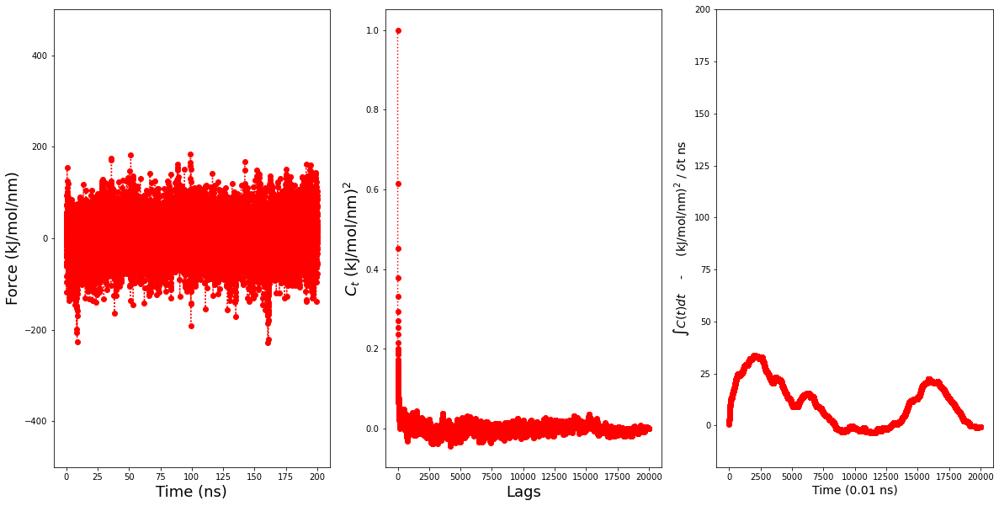

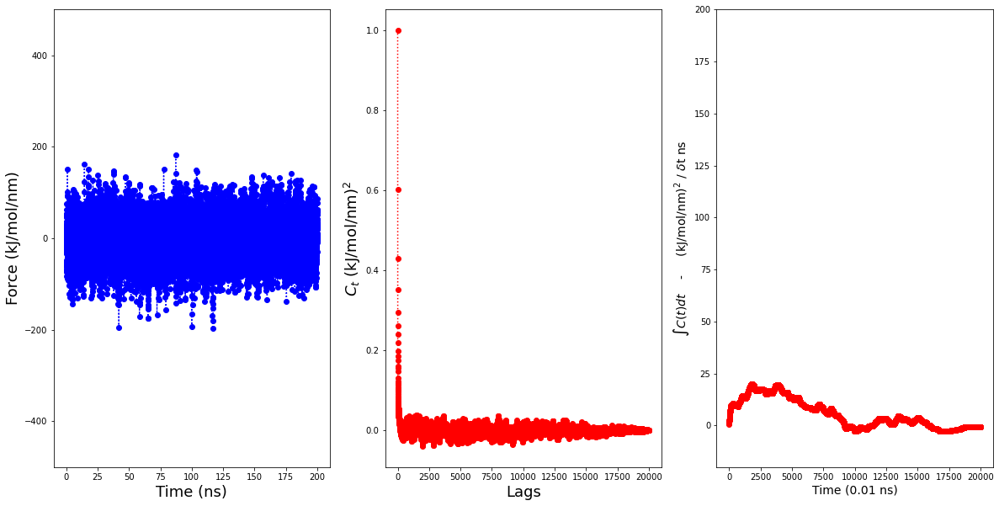

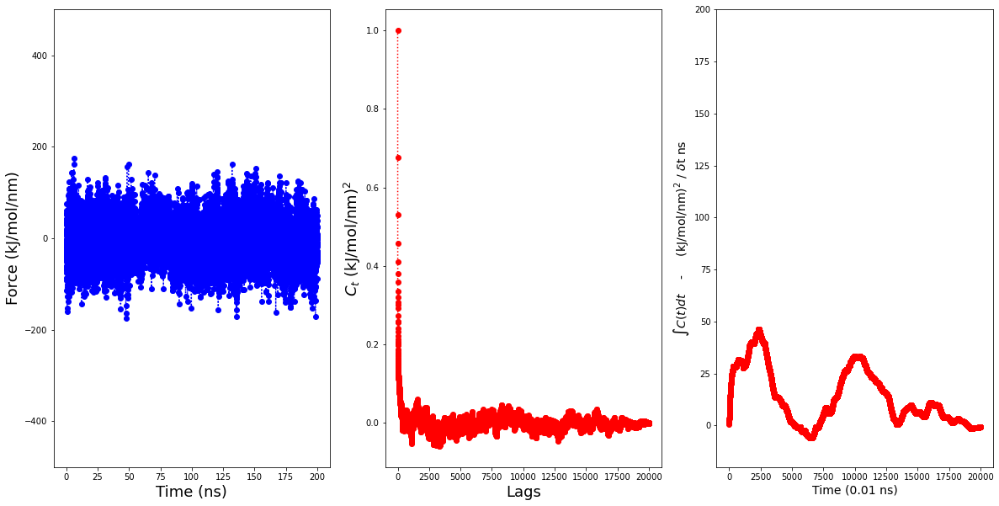

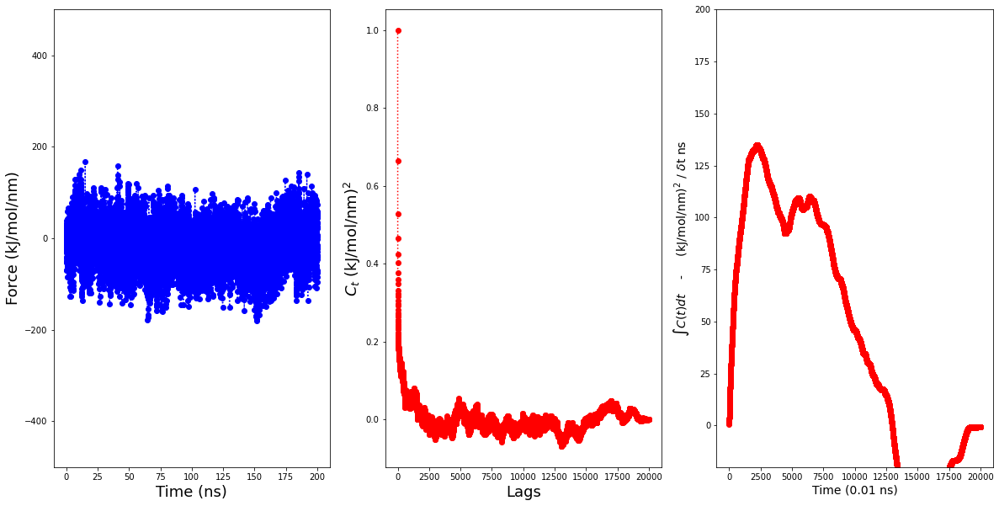

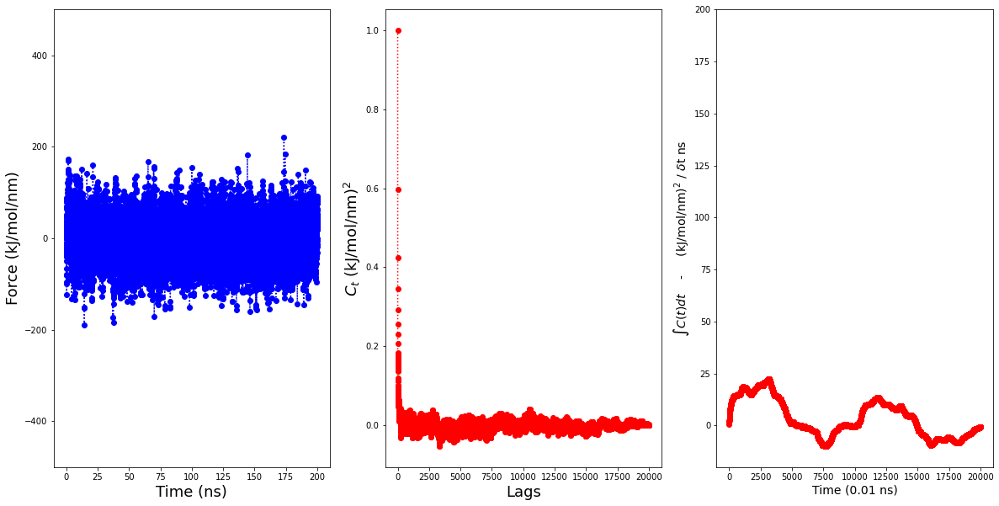

...

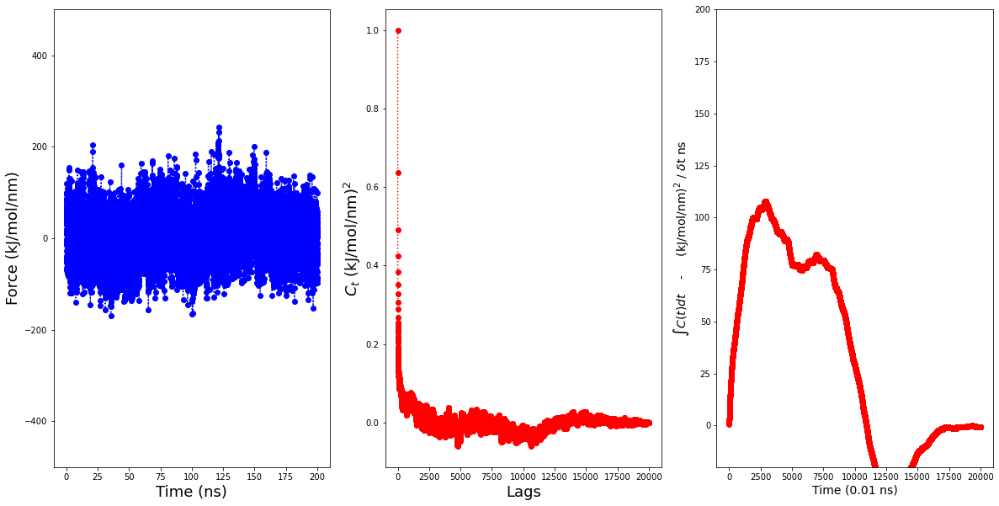

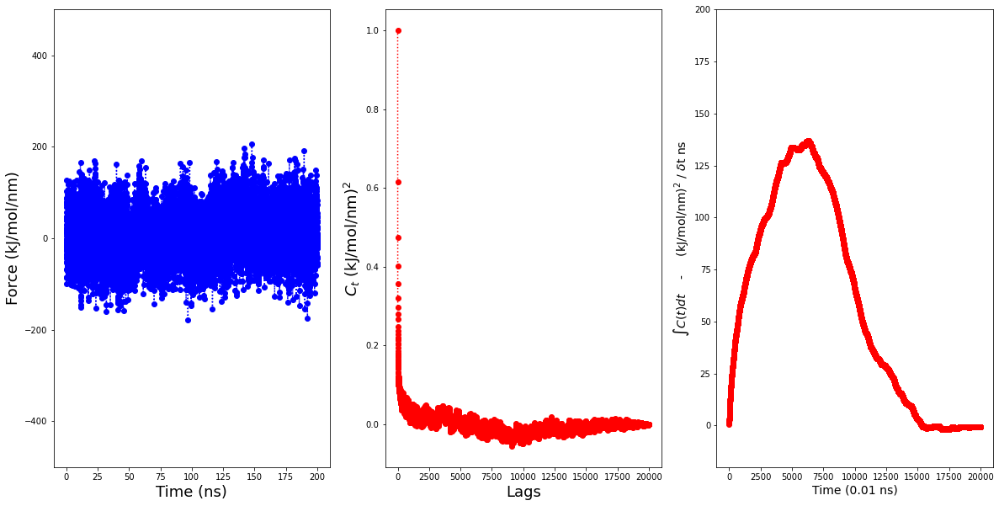

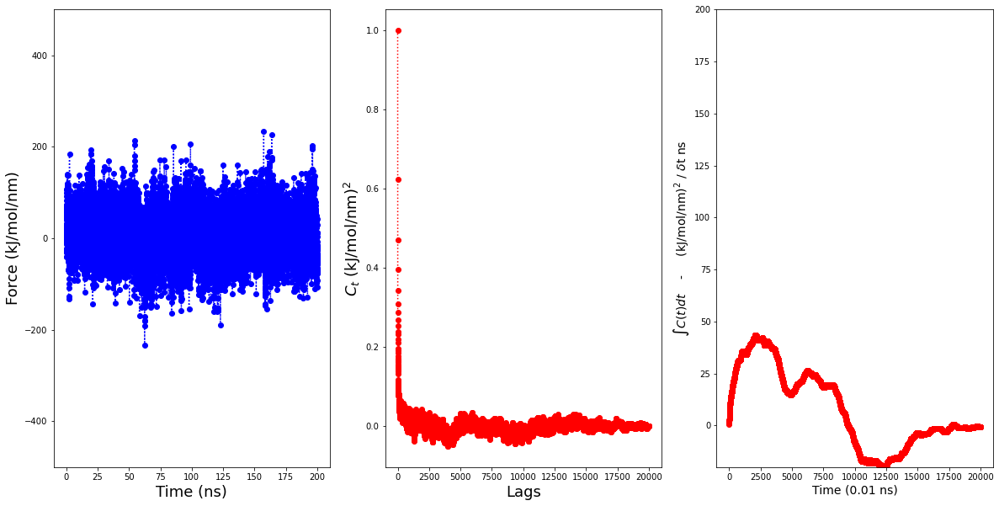

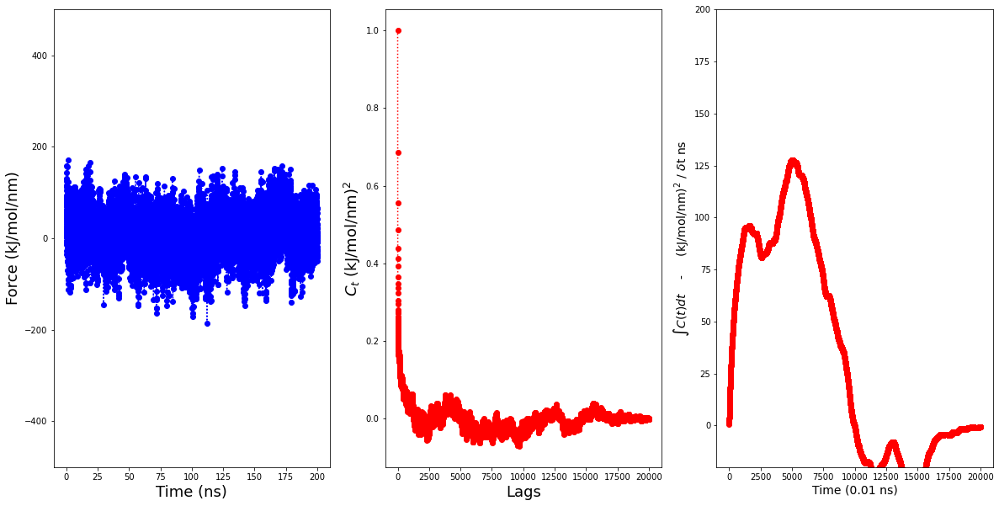

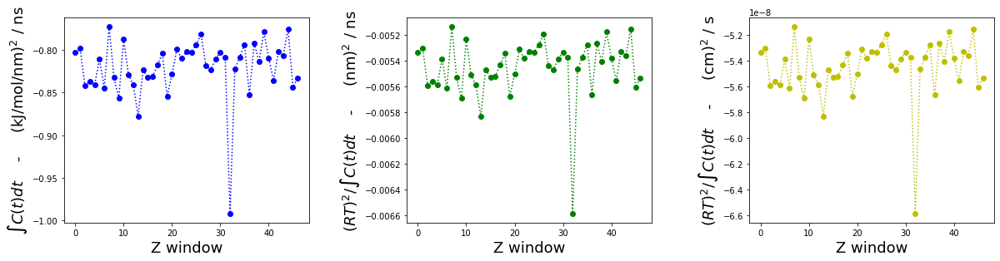

In [31]:
#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_Benzo_5000eq_0.2/Force_prod/All_new/Convolve_100')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=20000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           

            #np.savetxt("test.txt", bla5, delimiter=" ", fmt="%s") 
            #np.savetxt("test3.txt", save_acf, delimiter=" ", fmt="%s") 


            #np.savetxt("test2.txt", save_acf_, delimiter=" ", fmt="%s")

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = 6.64268

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = invert_last*6.64268
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100_Benzo.png',dpi=300,bbox_inches='tight',pad_inches=0.2)

1
[1.00000000e+00 6.45503393e-01 4.90461907e-01 ... 8.81662509e-04
 1.51302667e-03 4.44815620e-03]
[1.00000000e+00 6.45503393e-01 4.90461907e-01 ... 8.81662509e-04
 1.51302667e-03 4.44815620e-03]
2001
[ 0.56798265  1.02035103  1.41519571 ... 47.17922938 47.18042673
 47.18340732]
1999
48.01612918221738
1
2
[1.         0.64405527 0.49783782 ... 0.00359323 0.01055186 0.01205575]
[1.         0.64405527 0.49783782 ... 0.00359323 0.01055186 0.01205575]
2001
[ 0.57094654  1.03413929  1.43735732 ... 52.38537065 52.3924432
 52.403747  ]
1999
51.99921294776209
2
3
[1.         0.67699649 0.53331867 ... 0.03088719 0.02839309 0.02436332]
[1.         0.67699649 0.53331867 ... 0.03088719 0.02839309 0.02436332]
2001
[  0.60515758   1.10384791   1.54259939 ... 100.44897977 100.47861992
 100.50499812]
1999
99.1178592801831
3
4
[ 1.          0.65309148  0.49863504 ...  0.01460099  0.00768946
 -0.00113436]
[ 1.          0.65309148  0.49863504 ...  0.01460099  0.00768946
 -0.00113436]
2001
[ 0.57586326  1.

[ 0.61459563  1.12477787  1.579194   ... 62.3679966  62.39338068
 62.41764514]
1999
60.63831206911772
32
33
[1.         0.66315898 0.5023657  ... 0.00150013 0.00144337 0.00276664]
[1.         0.66315898 0.5023657  ... 0.00150013 0.00144337 0.00276664]
2001
[ 0.58276234  1.04329578  1.43443804 ... 31.59048813 31.59195988
 31.59406488]
1999
31.096101854794906
33
34
[1.         0.59003871 0.45087127 ... 0.03068292 0.02922987 0.02837405]
[1.         0.59003871 0.45087127 ... 0.03068292 0.02922987 0.02837405]
2001
[ 0.52045499  0.93793459  1.30122494 ... 81.41254331 81.44249971
 81.47130166]
1999
80.3737776469124
34
35
[1.         0.65860231 0.50958468 ... 0.06830247 0.07015811 0.06123239]
[1.         0.65860231 0.50958468 ... 0.06830247 0.07015811 0.06123239]
2001
[  0.5840935    1.05810546   1.47503787 ... 147.45422296 147.52345325
 147.5891485 ]
1999
144.0699997029361
35
36
[ 1.          0.68040381  0.53018356 ... -0.01371614 -0.01885229
 -0.02436739]
[ 1.          0.68040381  0.53018356

<Figure size 1440x432 with 0 Axes>

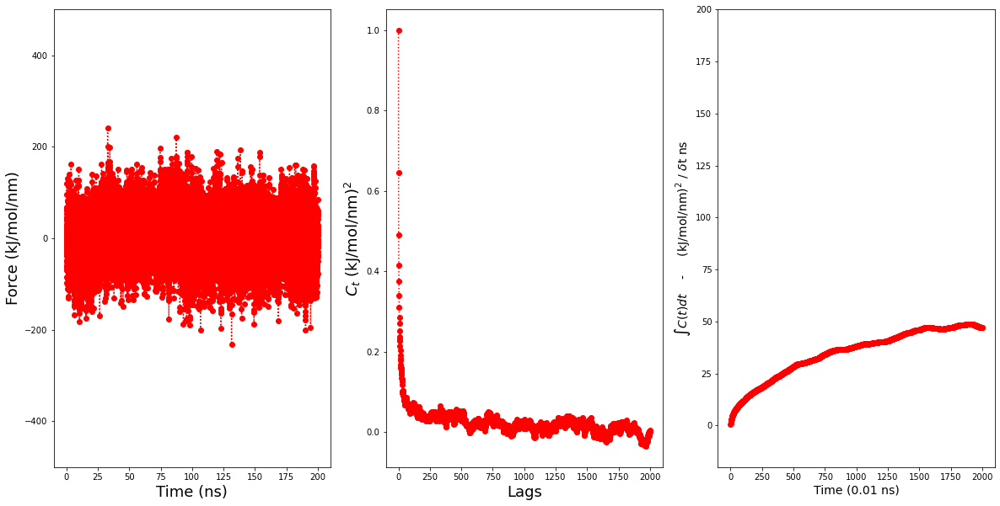

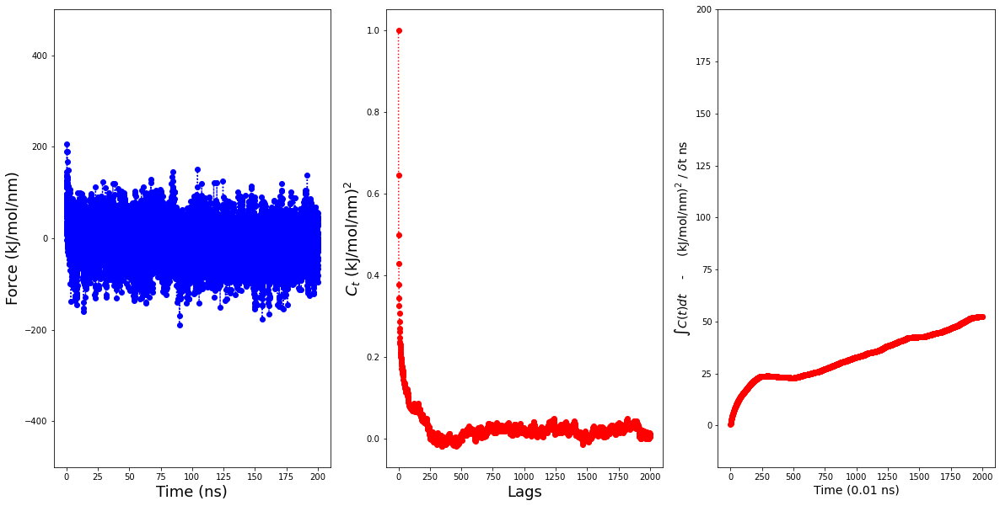

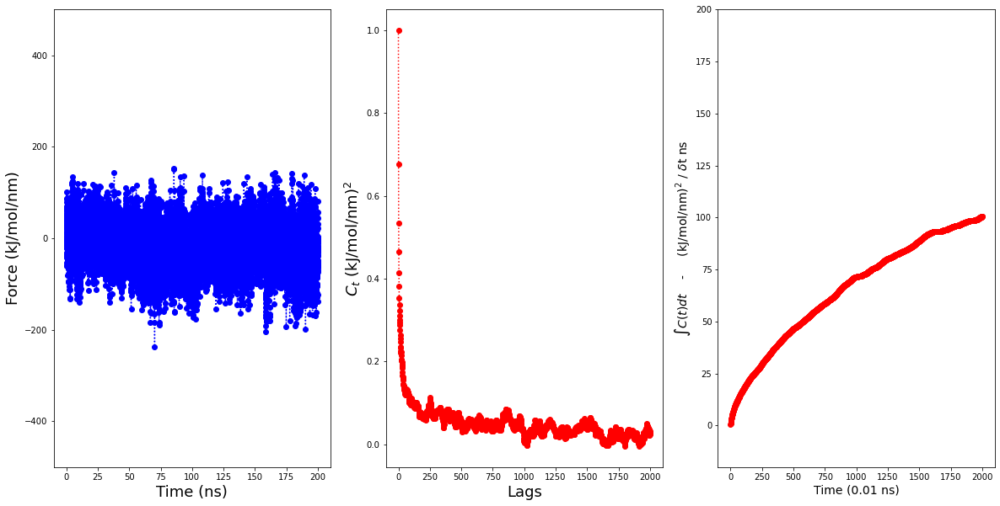

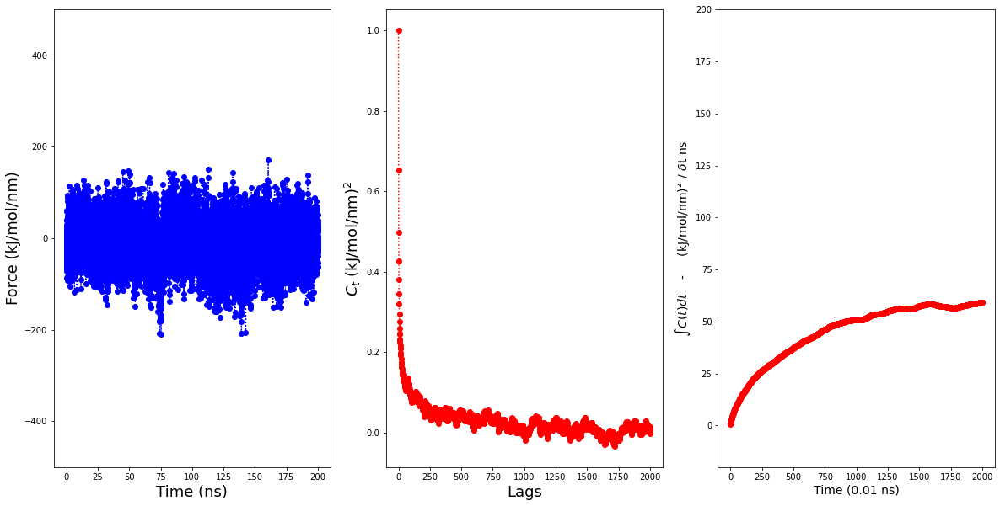

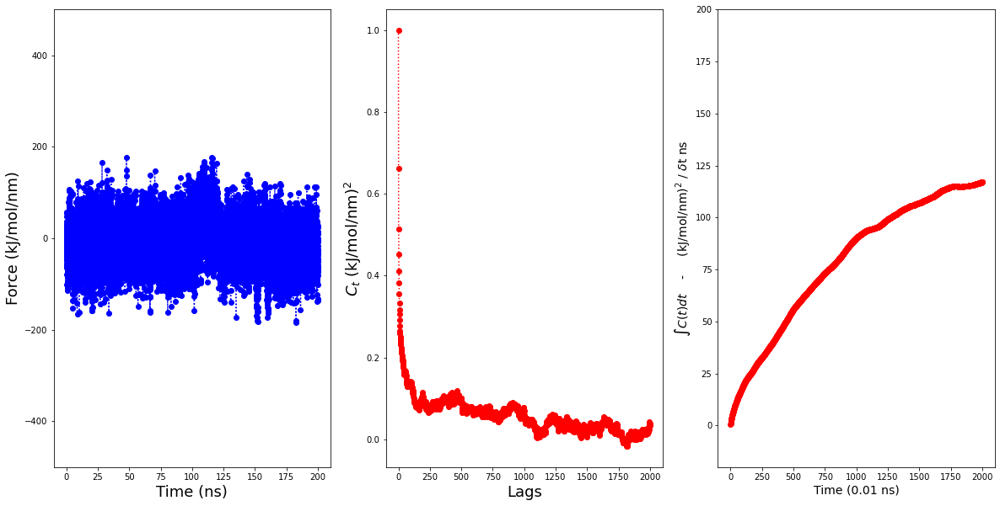

...

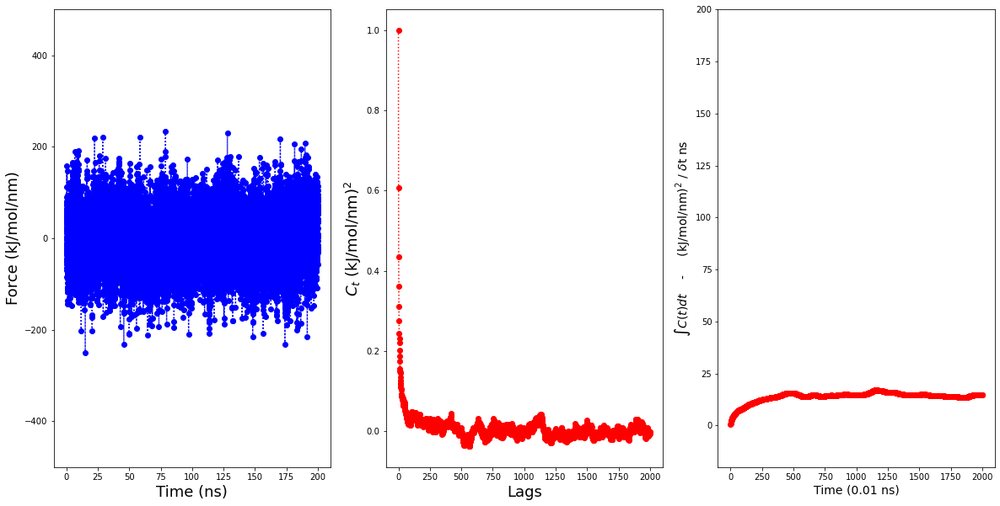

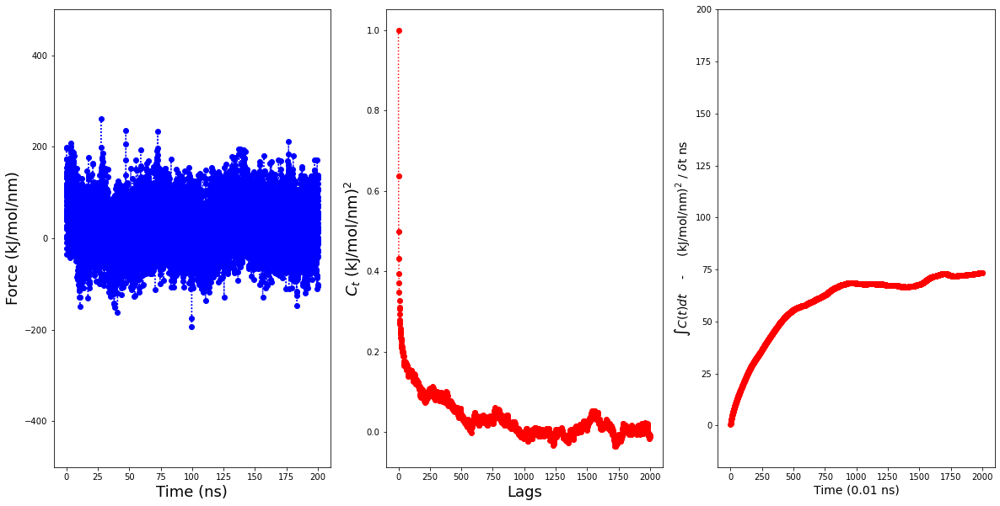

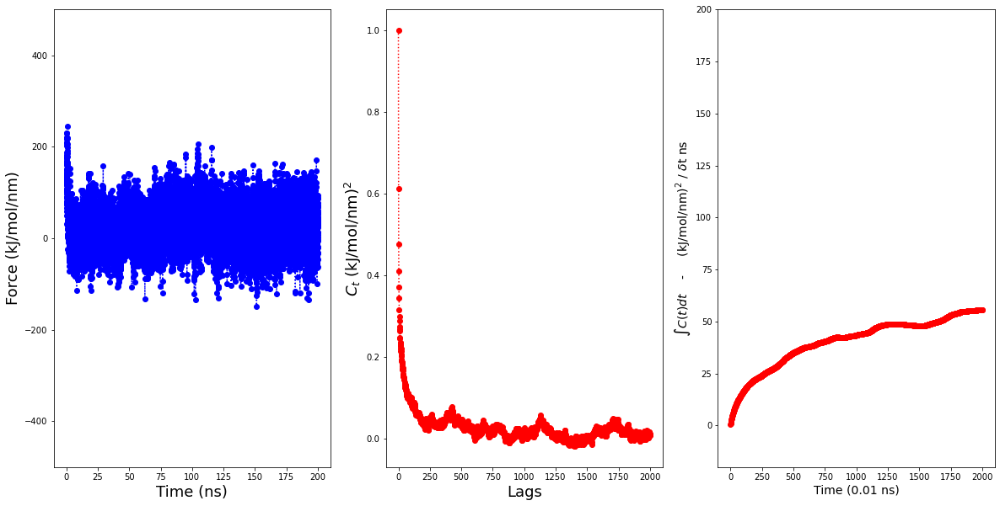

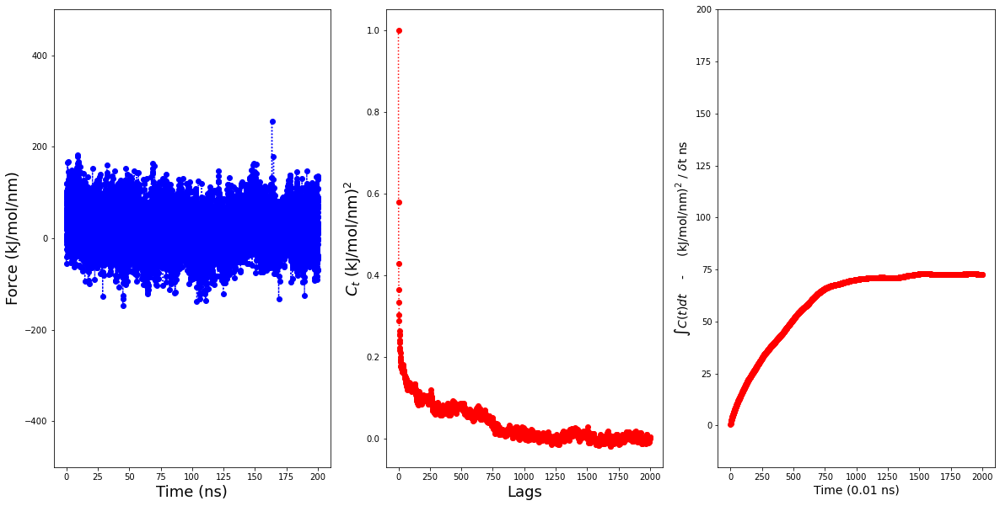

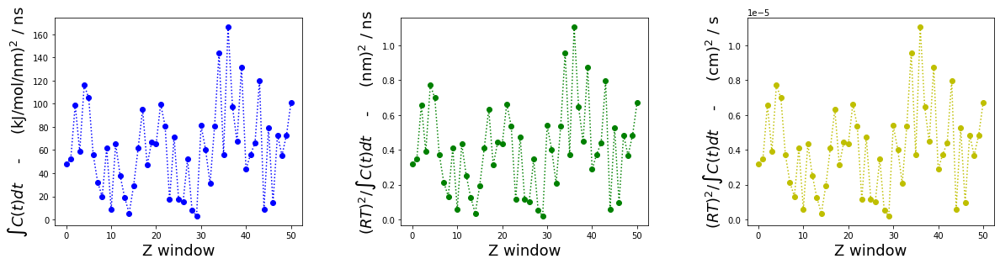

In [32]:

#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_2MR_DPG_5000eq_0.2/Force_prod/All_new2/Convolve_100')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=2000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           

            #np.savetxt("test.txt", bla5, delimiter=" ", fmt="%s") 
            #np.savetxt("test3.txt", save_acf, delimiter=" ", fmt="%s") 


            #np.savetxt("test2.txt", save_acf_, delimiter=" ", fmt="%s")

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = 6.64268

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = invert_last*6.64268
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100_2MR_DPG.png',dpi=300,bbox_inches='tight',pad_inches=0.2)



1
[1.00000000e+00 6.62735825e-01 5.02273750e-01 ... 2.70852516e-05
 8.53046916e-06 2.29861122e-06]
[1.00000000e+00 6.62735825e-01 5.02273750e-01 ... 2.70852516e-05
 8.53046916e-06 2.29861122e-06]
20000
[ 0.58250479  1.04475879  1.44256415 ... -0.83139228 -0.83137448
 -0.83136906]
19998
-0.8235808823487156
1
2
[ 1.00000000e+00  6.16395862e-01  4.53878810e-01 ...  4.88793890e-05
 -1.72554890e-05 -3.27454145e-05]
[ 1.00000000e+00  6.16395862e-01  4.53878810e-01 ...  4.88793890e-05
 -1.72554890e-05 -3.27454145e-05]
20000
[ 0.53513734  0.95207798  1.3090363  ... -0.80817237 -0.80815656
 -0.80818156]
19998
-0.8169389549660903
2
3
[1.00000000e+00 6.62837224e-01 5.01603225e-01 ... 4.92241967e-05
 6.35927237e-06 2.28702106e-06]
[1.00000000e+00 6.62837224e-01 5.01603225e-01 ... 4.92241967e-05
 6.35927237e-06 2.28702106e-06]
20000
[ 0.58222022  1.04638715  1.44962073 ... -0.83145187 -0.83142408
 -0.83141976]
19998
-0.8934743441671816
3
4
[1.00000000e+00 6.35235449e-01 4.65522188e-01 ... 8.1813239

20000
[ 0.58925129  1.06029055  1.46823563 ... -0.83377738 -0.8334909
 -0.83331378]
19998
-0.8526109935042111
27
28
[1.00000000e+00 6.42841843e-01 4.73189111e-01 ... 7.51617744e-05
 2.35126774e-05 9.14190859e-07]
[1.00000000e+00 6.42841843e-01 4.73189111e-01 ... 7.51617744e-05
 2.35126774e-05 9.14190859e-07]
20000
[ 0.55801548  0.98712745  1.34462193 ... -0.82148293 -0.82143359
 -0.82142138]
19998
-0.8219006340939281
28
29
[ 1.00000000e+00  6.62665820e-01  5.04017447e-01 ... -7.47371065e-06
 -5.70264526e-06  7.27135970e-07]
[ 1.00000000e+00  6.62665820e-01  5.04017447e-01 ... -7.47371065e-06
 -5.70264526e-06  7.27135970e-07]
20000
[ 0.58334163  1.04758126  1.44491531 ... -0.8313242  -0.83133079
 -0.83133327]
19998
-0.8339319349264529
29
30
[ 1.00000000e+00  6.30432203e-01  4.67889366e-01 ... -2.89094001e-05
 -6.33783502e-06 -1.03185067e-04]
[ 1.00000000e+00  6.30432203e-01  4.67889366e-01 ... -2.89094001e-05
 -6.33783502e-06 -1.03185067e-04]
17369
[ 0.54916078  0.97545977  1.33644926 .

<Figure size 1440x432 with 0 Axes>

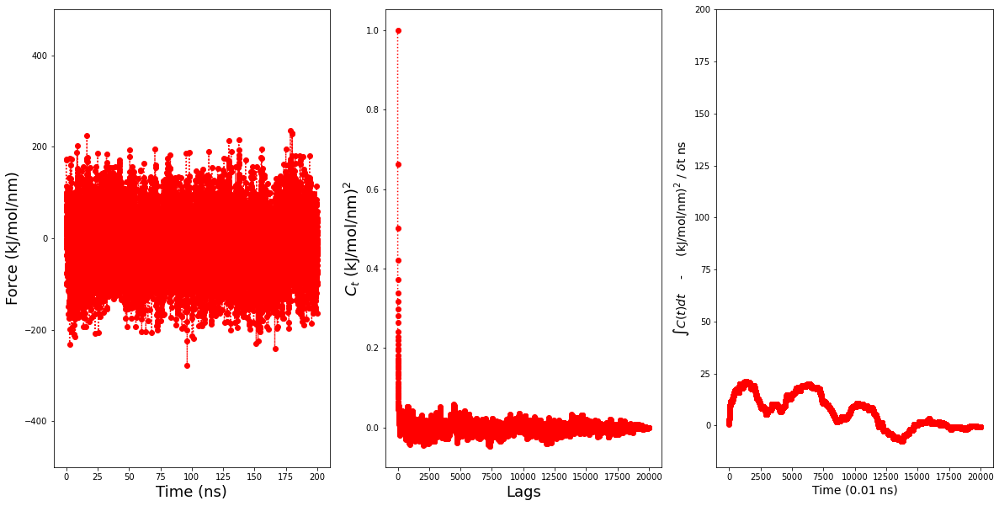

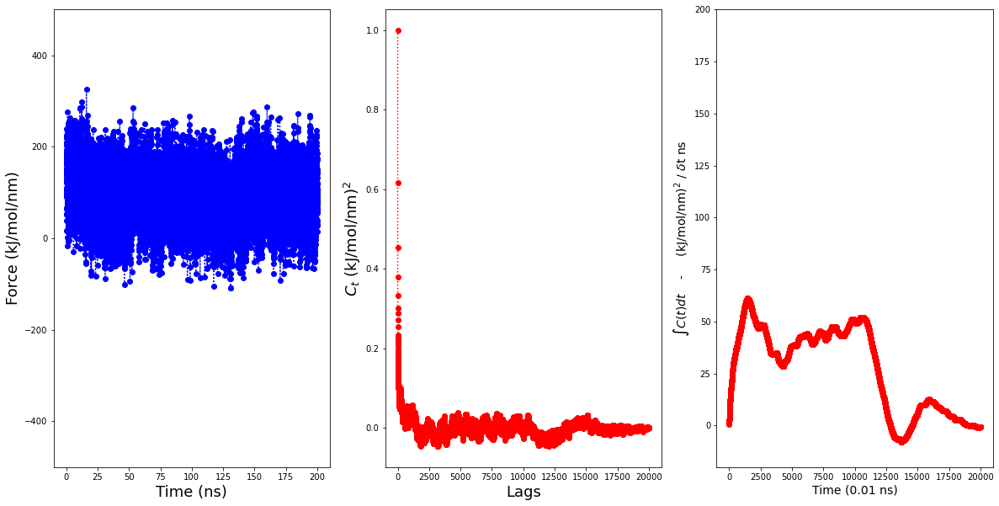

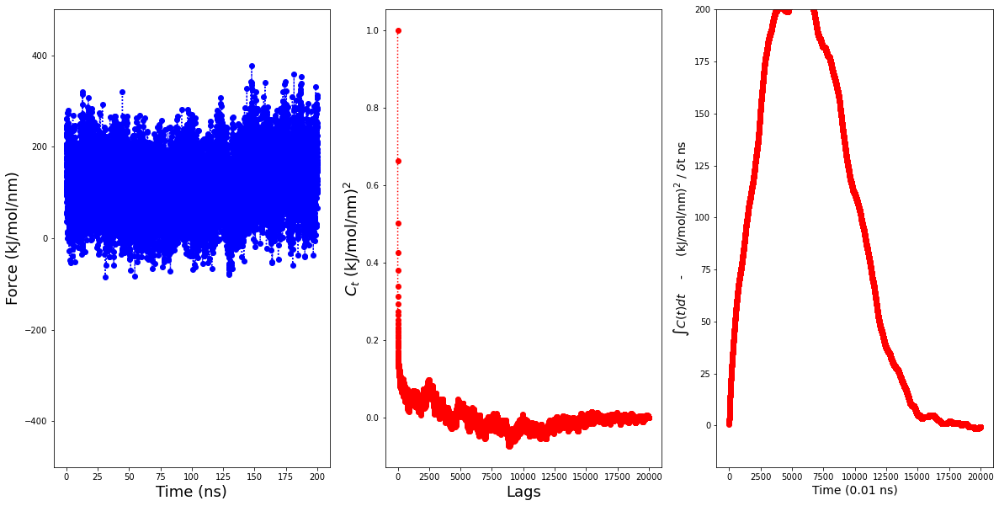

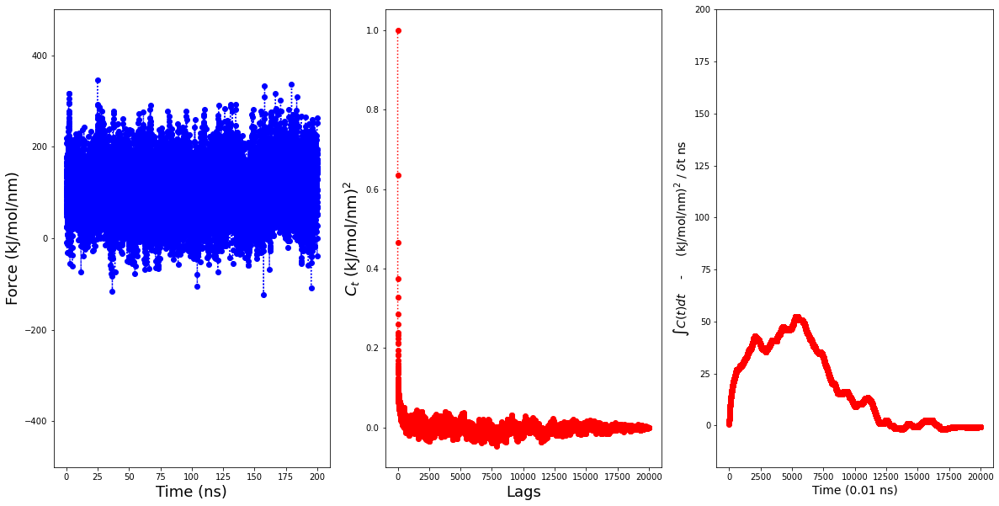

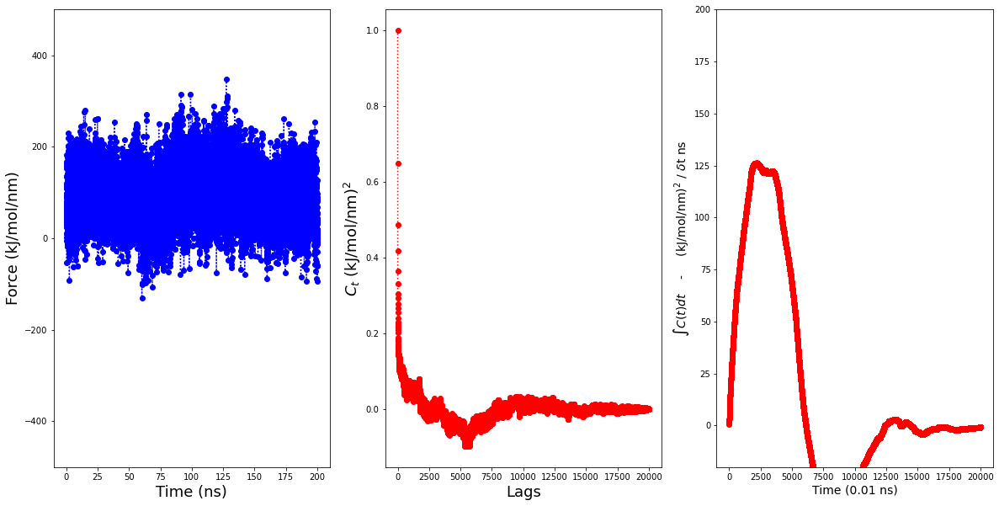

...

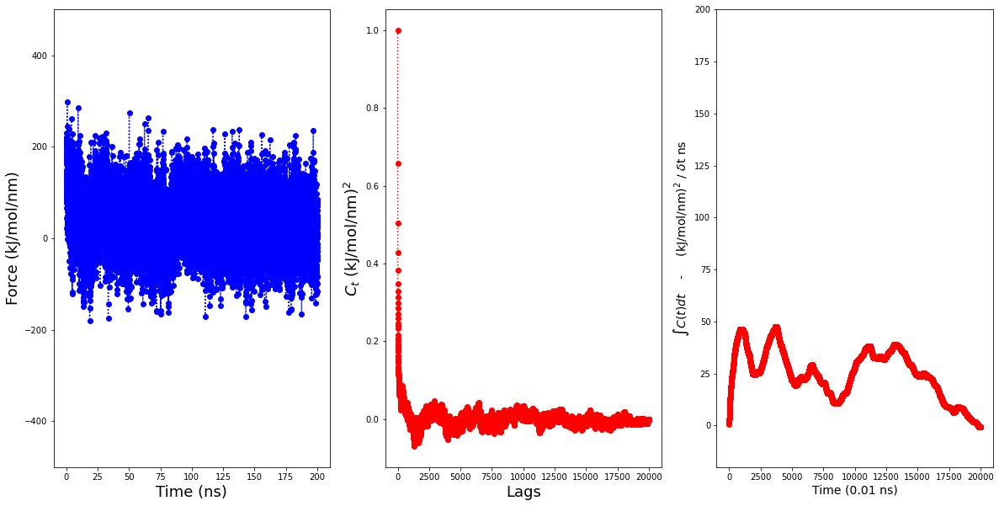

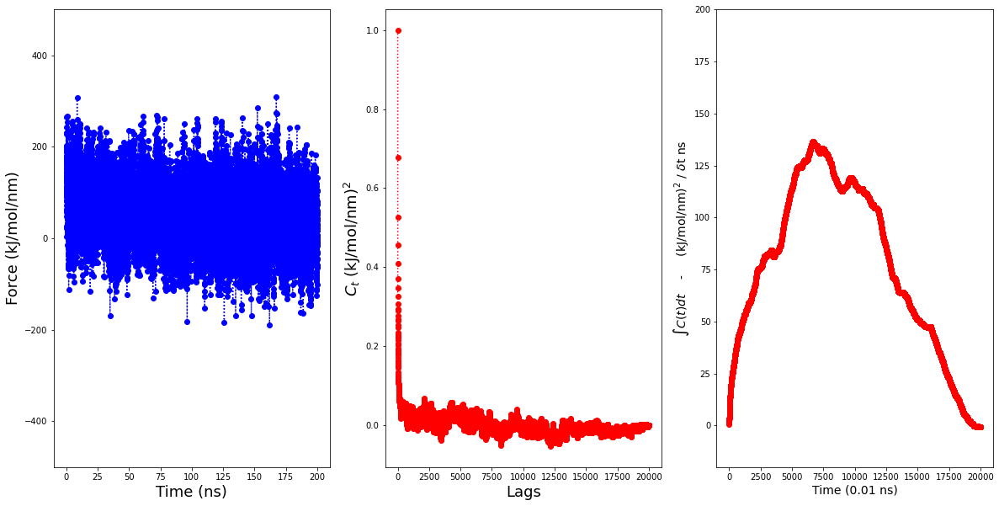

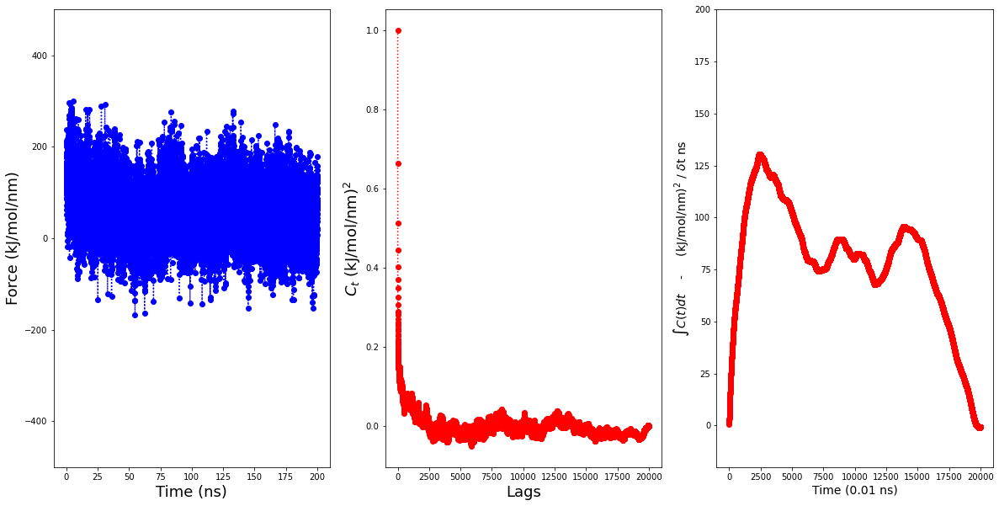

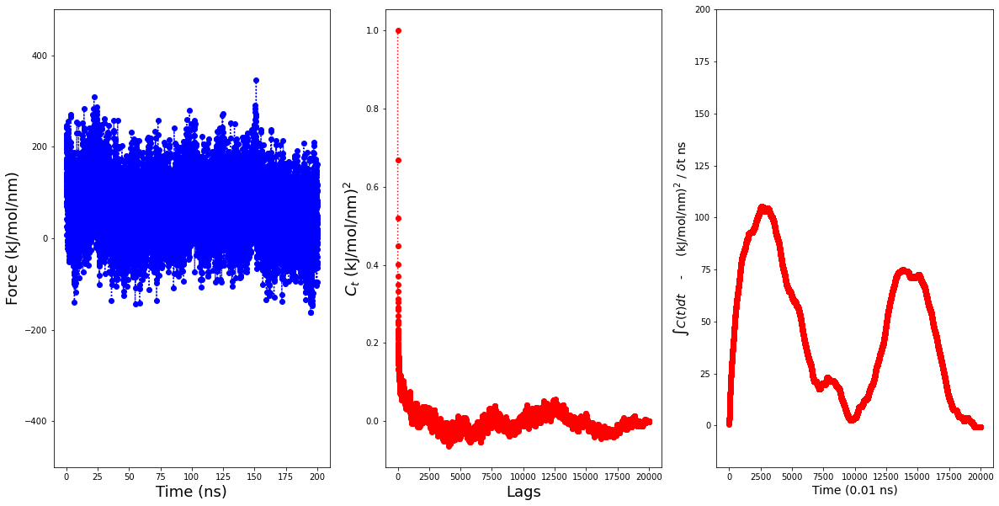

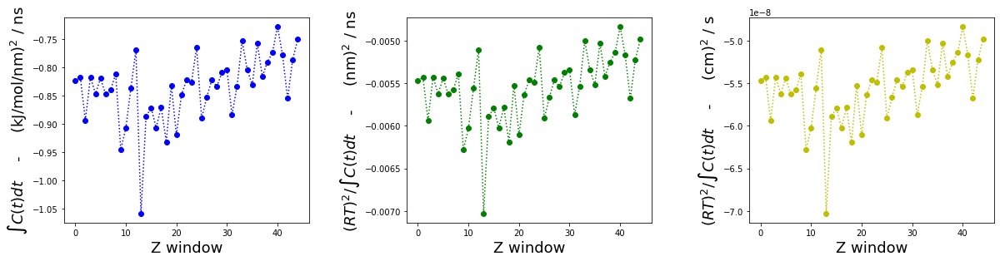

In [33]:
#Original data, 100, 1000. 
#Red, blue, black and purple at 500,000. 

#Correlation func & Integral: 1, 100, 1000.

#Auto-correlation
from statsmodels.graphics import tsaplots

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob 
import errno
import statsmodels.api as sm
import scipy.integrate as scint
from scipy import integrate

from numpy import array, hstack, vstack


import itertools

last = []
dz = []
bl = []
bla = range(20000)
bla2 = array([bla])
save_acf = array([bla])

bla3 = save_acf.T

bla4 = np.empty(shape=(20000,) * 1)

plt.figure(figsize=(20,6))
count=1

# create subplots

os.chdir('/Users/chrisjorg/Documents/Postdoc/Georgetown/Double_bilayer_Sandwich/Z_LPP/LPP_Caff_DPG_5000eq_0.2/All_test4/Convolve')
with open('data.txt', 'w') as file:
    path = './*pullf.xvg' 
    path2 = os.getcwd()
    files = glob.glob(path)
    colors = itertools.cycle(["r", "b", "g","y","c","m"])
    
def key_func(x):
        return os.path.split(x)[-1]

for name in sorted(glob.glob('*_pullf.xvg_dt*'), key=key_func):
        try: 
            print(count)
            
            lines = open(name,'r')
            f = np.loadtxt(name)
            #plt.subplot(1, 1, count) 

            subplot_dim = (20, 10)
            X_=f[:,0]/1000
            Y=f[:,1]
            X_scale = np.linspace(0, 1, 20000) 
            
            X_scale_ = X_scale/100
            
           
            
            
            fig, (ax0, ax1, ax2) = plt.subplots(1, 3,figsize=(20,10))
            ax0.plot(X_,Y,':ro',label=name,color=next(colors))
             
            ax0.set_ylabel('Force (kJ/mol/nm)',fontsize=18)
            ax0.set_xlabel('Time (ns)',fontsize=18)
             
            ax0.set_ylim(-500, 500)

            colors = itertools.cycle(["r", "b", "g","y","c","m"])
            
            acf_ = sm.tsa.acf(Y,  nlags=20000)
            
            acf__ = acf_.T
            print(acf__)
            print(acf_)
            blbb = np.concatenate(([X_scale, X_, Y]), axis=0) 
            np.savetxt('AutoCorr_100_' + str(count) + '.txt', acf_, delimiter=" ", fmt="%s")

            #bla4 = hstack([bla4, save_acf, acf_])
            #np.savetxt("acf.txt", save_acf_, delimiter=" ", fmt="%s")
            
            
            #bla5 = hstack([ bla4, Y])
            save_acf__ = hstack([ X_, Y])
           

            #np.savetxt("test.txt", bla5, delimiter=" ", fmt="%s") 
            #np.savetxt("test3.txt", save_acf, delimiter=" ", fmt="%s") 


            #np.savetxt("test2.txt", save_acf_, delimiter=" ", fmt="%s")

            ax1.plot(acf_,':ro',label=name,color=next(colors)) 
            ax1.set_ylabel('$C_{t}$ (kJ/mol/nm)$^2$',fontsize=18)
            ax1.set_xlabel('Lags',fontsize=18)
            
            print(len(acf_))
            colors = itertools.cycle(["r", "b", "g","y","c","m"])

            X_scale = np.linspace(0, 1, 2000)
            acf__ = acf_[1:]
            acf_int = integrate.cumtrapz(acf__)
   
            np.savetxt("dz_integrat.txt", acf_int, delimiter=" ", fmt="%s")

            
            X_scale = np.linspace(0, 1, 1999)
      
            ax2.plot(acf_int,':ro',label=name,color=next(colors))
            ax2.set_ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / $\delta$t ns',fontsize=14)
            ax2.set_xlabel('Time (0.01 ns)',fontsize=14)
            ax2.set_ylim(-20, 200)
             
            count+=1
             
            fig.savefig('AutoCorr_100_' + str(count) + '.png',dpi=300,bbox_inches='tight',pad_inches=0.06)
            print(acf_int)
            print(len(acf_int))
            last_element = acf_int[len(acf_int) - 1]
            last100 = acf_int[-100:]
            last_element_ = np.average(last100)
            #last_element_ = 100*last_element
            print(last_element_)
            last.append(last_element_)
            print(len(last))
        except IOError as exc: 
            if exc.errno != errno.EISDIR: 
                raise

np.savetxt("test5.txt", blbb, delimiter=" ", fmt="%s") 

# Display the autocorrelation plot of your time series

print(len(last))

last_arr = np.array(last)
last_ = last_arr

print(len(last_))
rt = 0.008314*310   #kJ/mol
rt2_ = 6.64268

dt = 0.001 

dt1 = 1/dt
invert_last = 1. / dt1*last_
print(len(invert_last))
print(invert_last)
#invert_last = np.reciprocal(last_)
fraction = invert_last*6.64268
fraction_units = fraction*0.00001

plt.subplot(2, 3, 4)
#plt.plot(last_,':ro',label=name,color=next(colors))

plt.plot(last_,':ro',label=name,color=next(colors))
plt.ylabel(r'$\int C(t) dt $    -     (kJ/mol/nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 50000)

plt.subplot(2, 3, 5)
plt.plot(fraction,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (nm)$^2$ / ns',fontsize=18)
plt.xlabel('Z window',fontsize=18)
#plt.xlim(0, 100)

plt.subplot(2, 3, 6)

plt.plot(fraction_units,':ro',label=name,color=next(colors))
plt.ylabel('$(RT)^{2} / \int C(t) dt $    -     (cm)$^2$ / s',fontsize=18)
plt.xlabel('Z window',fontsize=18)
np.savetxt("last_element_.txt", last, delimiter=" ", fmt="%s")
plt.ticklabel_format(useOffset=False)

np.savetxt("dz.txt", fraction_units, delimiter=" ", fmt="%s")
 
plt.subplots_adjust(wspace=0.4)
            
#plt.tight_layout()
plt.savefig('AutoCorr_100_Caf_DPG.png',dpi=300,bbox_inches='tight',pad_inches=0.2)
